# <CENTER>**📊 IV. EXPLORATORY DATA ANALYSIS (EDA) - `PART 1` 📊**<CENTER>
---

## **🏙️ INTRODUCTION**
Gurugram (formerly Gurgaon), located in the National Capital Region (NCR) of India, has emerged as one of the country’s most dynamic real estate markets. Known for its rapid urban development, corporate hubs, and premium residential projects, Gurugram attracts buyers ranging from working professionals and nuclear families to luxury-seeking investors. Over the last decade, the city has witnessed continuous expansion, with new residential sectors, gated societies, and high-rise apartments becoming the backbone of its housing supply.

This notebook presents **Exploratory Data Analysis (EDA)** of flat listings in Gurugram, collected from major online real estate portals such as **Housing.com and 99acres**. The dataset includes detailed information on flat configurations, pricing, area, furnishing status, amenities, sector-level distribution, builder/seller details, and more.

### **Through this EDA, we aim to:**

* Understand the **distribution of flat types** (1 BHK, 2 BHK, 3 BHK, etc.) across the city.
* Compare **pricing trends** across sectors and property sizes.
* Explore the role of **amenities, furnishing, parking, and society features like parking** in influencing property prices.
* Identify **sector-level costliness**, highlighting expensive and affordable clusters.
* Derive insights for **buyers, investors, and developers** about prevailing market trends.

The Gurugram housing market is **often described** as **mid-segment driven**, dominated by **2 BHK and 3 BHK flats**, with limited but significant presence of luxury and ultra-luxury properties. At the same time, affordability and sector-level differences play a crucial role in shaping buyer preferences. This analysis will uncover such patterns and provide a data-backed perspective on Gurugram’s residential real estate landscape.


---
---

<br>

### **IMPORTING DATA :**

In [43]:
## Importing necessary tools for Data Manipulation and Visualisation:
import pandas as pd                      ## Pandas for data manipulation
pd.options.display.max_columns = None

import numpy as np                       ## Numpy for mathematical computation
import matplotlib.pyplot as plt          ## pyplot module of Matplotlib for visualization

import seaborn as sns                    ## Seaborn for visualization
import plotly.graph_objects as go        ## Plotly for dynamic and interactive visualization
import plotly.express as px
from plotly.subplots import make_subplots

from wordcloud import WordCloud          ## For making Word Cloud

import All_graphs_module as myplots      ## Importing module in which all my poltting logic and code is saved
                                          
from PIL import Image
import warnings
warnings.filterwarnings("ignore")        ## Hides all warnings

In [44]:
df = pd.read_csv('Housing_Listings_all_records_(numbers)_FINAL_Cleaned_FE.csv', index_col = 'Unnamed: 0')
df.head(2)

,Flat,Sector,Address,Seller_Builder,EMI,EMI_in_rupees,Built_Up_Area,Built_up_area_in_sqft,Avg_Price,Avg_price_rupee_per_sqft,Age_of_property,Age_of_property_in_years,Possession_status,Floor,Floor_number,Building_height,Facing,Furnishing,Society,Brokerage,Brokerage_in_rupees,Price,Price_in_rupees,Bedrooms,Bathrooms,Parking,Covered_parking,Open_parking,Balcony,Advertised,Amenities,Nearby_landmarks,Prop_description,Link,Sector_Amenity_Score
0,2 BHK Flat,Sector 86,"Pyramid Elite, Sector 86, Gurgaon",Pyramid Infratech Private Limited,EMI starts at ₹36.01 K,36010,593 sq.ft,593,₹11.47 K/sq.ft,11470.0,1 Years Old,1,Ready to move,12 of 14,12,14,East facing,Semi Furnished,Pyramid Elite,"68,000",68000,68.0 L,6800000,2,2,1 Open Parking,0,1,1,More than a month ago,"['Lift', 'Power Backup', 'Garden', 'Sports', '...","[['School', ""St. Xavier's High School""], ['Hos...",Looking for a 2 BHK Flat for sale in Gurgaon? ...,https://housing.com/in/buy/resale/page/1761033...,2.0
1,2 BHK Flat,Sector 86,"Pyramid Elite, Sector 86, Gurgaon",Pyramid Infratech Private Limited,EMI starts at ₹33.36 K,33360,690 sq.ft,690,₹9.13 K/sq.ft,9130.0,1 Years Old,1,Ready to move,4 of 15,4,15,-,Unfurnished,Pyramid Elite,"63,000",63000,63.0 L,6300000,2,2,No Parking,0,0,1,17 days ago,NaN,"[['School', ""St. Xavier's High School""], ['Hos...",Best 2 BHK Flat for modern-day lifestyle is no...,https://housing.com/in/buy/resale/page/1681859...,2.0


<br><br>

# **`I. 🏢 Flat / Property Type`**
---

## **`A.` What are the different kinds of Flats available for sale in Gurgaon?**
## **`B.` What is the portion of each Flat type in the overall flat market?**

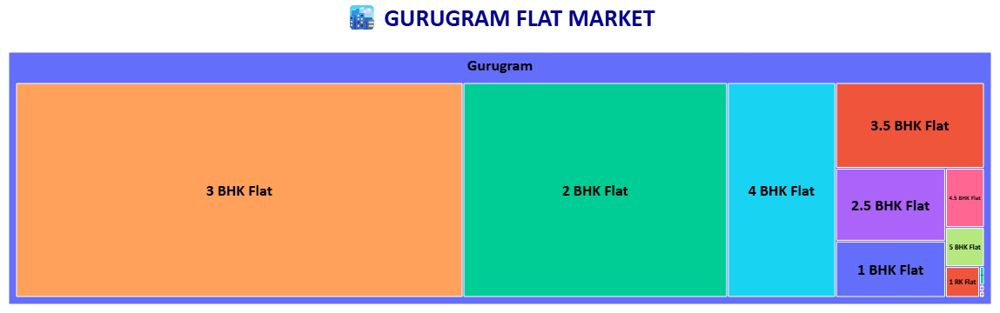

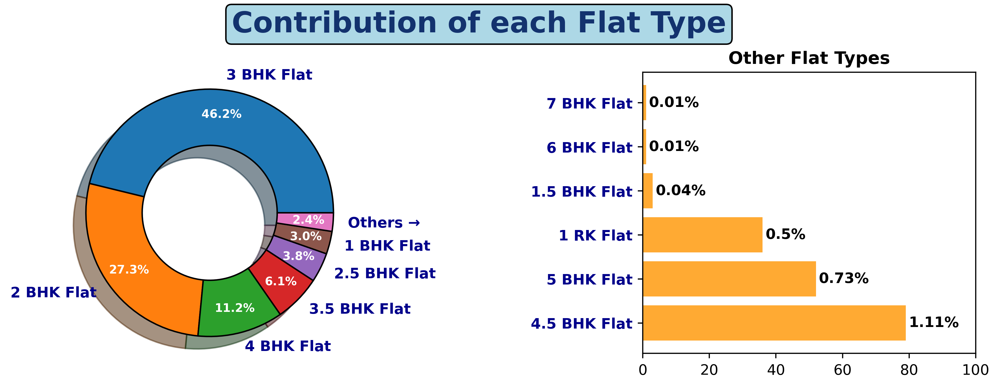

In [9]:
def What_are_the_different_kinds_of_Flats_available_for_sale_in_Gurgaon():
    ## Creating a TreeMap:
    fig = px.treemap(df, path=[px.Constant('Gurugram'),'Flat'], 
                     values = pd.Series(np.ones(7143)).astype('int8'),
                     color = 'Flat' , color_continuous_scale='Viridis', # change color palette
                    )
    
    fig.update_layout(autosize=True, margin=dict(l=10, r=10, t=60, b=10),
                      title=dict(text="<b>🏙️ GURUGRAM FLAT MARKET</b>",
                                 font=dict(size=28, color="darkblue", family='Calibri'),
                                 x = 0.5,  # center title
                                 pad=dict(t=50, b=0, l=20, r=20)),
                      paper_bgcolor='white')
    
    fig.update_traces(textinfo="label",
                      # textinfo="label+percent parent",
                      hovertemplate='<b>%{label}</b><br>Count: %{value}<br>City: %{parent}<extra></extra>',
                      textfont=dict(size=18, color="black", family="Calibri black"),
                      textposition="middle center",
                      tiling=dict(pad=2)  # extra padding between boxes
                     )
    
    fig.show()

def What_is_the_portion_of_each_Flat_type_in_the_overall_flat_market():
    fig = plt.figure(figsize = (14, 3.5), dpi=400)
    ax1 = fig.add_subplot(1, 3, (1,2))
    ax2 = fig.add_subplot(1, 3, 3)
    
    top_6_data = df['Flat'].value_counts().sort_values(ascending = False).head(6)
    other_data = df['Flat'].value_counts().sort_values(ascending=False)[6:].sum()
    data_pie = pd.concat([top_6_data, pd.Series([other_data], index = ['Others →'])])
    
    wedges, texts, autotexts = ax1.pie(x = data_pie, labels = data_pie.index , autopct='%0.1f%%', 
                                       pctdistance=0.8, shadow=True, labeldistance = 1.12, radius=1.1,                                   
                                       wedgeprops ={'linewidth':1 , 'edgecolor':'black', 'width':0.5})
    for t in texts:
        t.set_fontsize(10)
        t.set_color('darkblue')
        t.set_fontweight('bold')
    
    for at in autotexts:
        at.set_fontsize(8)
        at.set_fontweight('bold')
        at.set_color('white')
    
    
    other_flats = df['Flat'].value_counts().sort_values(ascending=False)[6:]
    bar = ax2.barh(other_flats.index , other_flats , color='#FFAA33')
    
    ax2.set_title('Other Flat Types', fontsize=12, fontweight='bold')
    ax2.set_yticks(list(range(0,6)))
    ax2.set_yticklabels(other_flats.index, fontsize=10, color='darkblue', fontweight='bold')
    ax2.set_xlim(0, 100)
    
    percent_of_total_flat = round((other_flats / (data_pie.sum())) * 100 , 2).apply(lambda x: str(x) + "%")
    ax2.bar_label(bar, labels = percent_of_total_flat, padding=2, fontsize=10, color='black',
                  fontweight='bold')
    
    fig.suptitle("Contribution of each Flat Type" , 
                  fontweight = 'bold', fontsize = 20, color = '#13326E', ha='center', x=0.56, y=1.05,
                 bbox={'facecolor': 'lightblue',     # Background color
                       'edgecolor': 'black',         # Border color
                       'boxstyle': 'round, pad=0.2', # Rounded box, with padding
                       'linewidth': 1                # Border thickness
                      })
    
    fig.show()



What_are_the_different_kinds_of_Flats_available_for_sale_in_Gurgaon()
What_is_the_portion_of_each_Flat_type_in_the_overall_flat_market()

### **`🔍 OBSERVATIONS`** 
We have **Gurugram flat market composition** by **BHK type**, with the **largest share in 3 BHK, followed by 2 BHK and 4 BHK**; smaller niches include 3.5, 2.5, 1, 4.5, 5 BHK, and 1 RK segments.

- ✨ **Dominance of 3 BHK Flats :**
    + 3 BHK flats clearly dominate the Gurgaon flat market, accounting for **46.2%** of the total supply.
    + This **indicates** a **strong buyer and builder preference** for **mid-sized family-oriented flats**.
<br><br>
- ✨ **2 BHK Flats as Second Most Common :**
    + 2 BHK flats form the **next largest segment** with **27.3% share**.
    + **Together, 2 BHK and 3 BHK flats constitute nearly three-fourths of the market (73.5%)**, highlighting that **Gurgaon’s residential market is largely mid-segment driven**.
<br><br>
- ✨ **Presence of Larger Flats (4+ BHK) :**
   * 4 BHK flats contribute **11.2%**, making them the **most significant option in the premium/luxury segment**.
   * Other **configurations like 3.5 BHK (6.1%), 2.5 BHK (3.8%), and 4.5 BHK (1.1%) exist but in much smaller proportions**.
<br><br>
- ✨ **Small Flats Have Limited Share :**
   * **1 BHK flats** account for only **3.0%**, while **studio-type units like 1 RK (0.5%)** have **negligible presence**.
   * This suggests that Gurgaon is **not a strong market for single professionals or students**, unlike metro city cores.
<br><br>
- ✨ **Very Rare Configurations :**
   * **Large luxury configurations** like **6 BHK and 7 BHK** are **almost absent (≈0.01%), catering to an ultra-niche segment**.
   * Similarly, smaller variants like **1.5 BHK (0.04%)** show **very limited demand and supply**.
<br><br>
- ✨ **Overall Market Structure :**
   * The Gurgaon market is **skewed towards family-sized apartments (2–3 BHKs)** with **limited presence** of **compact units** and **ultra-luxury flats**.
   * Builders seem to be targeting **nuclear and joint families** more than singles, bachelors, or niche luxury buyers.

---

### **`CONCLUSION :`**` Contribution of Each Flat Type with Market Implications`
The analysis of flat types in Gurgaon highlights a strong dominance of family-sized housing units, with **3 BHK flats alone accounting for 46.2% of the total market**. This is followed by **2 BHK flats (27.3%)**, meaning that together, these two categories constitute more than **73% of the available supply**. This dominance reflects a **clear builder and buyer preference for mid-sized family apartments**, which continue to drive the majority of Gurgaon’s housing demand. **4 BHK flats (11.2%)** emerge as the most significant option within the premium segment, while intermediate configurations like **3.5 BHK (6.1%)** and **2.5 BHK (3.8%)** target more specialized buyer needs. On the other hand, **smaller units such as 1 BHK (3.0%) and 1 RK (0.5%) are relatively rare**, suggesting that Gurgaon’s housing supply does not strongly cater to students, bachelors, or transient professionals — a market segment more common in city cores. Similarly, **ultra-luxury flats (6 BHK and 7 BHK) are almost non-existent (\~0.01%)**, underscoring their niche positioning for very high-net-worth buyers.

From a **market perspective**, this skew implies that **developers are aligning their projects with the preferences of nuclear and joint families**, which dominate Gurgaon’s homebuyer base. For **investors**, this suggests that 2 BHK and 3 BHK flats are the safest and most liquid investments, given their widespread availability and higher resale potential. For **buyers**, it highlights that compact and ultra-luxury housing options are limited, potentially leading to premium pricing in those categories due to lower supply. Overall, Gurgaon’s flat market emerges as **mid-segment driven**, with balanced opportunities in the premium family housing space but fewer avenues in compact urban living or ultra-luxury developments.


<br><br>

---
# **`C.` Average Built-up Area across 5 major Flat types (as per number of listings).**

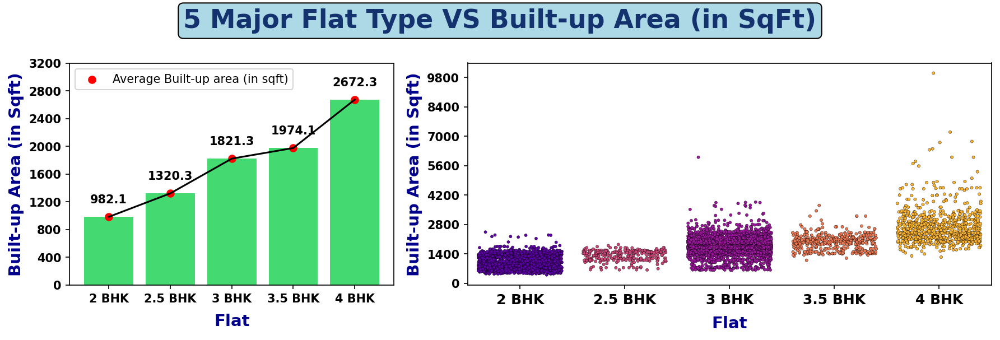

In [124]:
def What_is_the_Average_Builtup_Area_across_5_major_Flat_types():
    ## Preparing data for analysis:
    five_maj_ft = ["2 BHK Flat", "2.5 BHK Flat", "3 BHK Flat",  "3.5 BHK Flat", "4 BHK Flat"]
    data = df[df['Flat'].isin(five_maj_ft)].groupby(by = 'Flat')['Built_up_area_in_sqft'].mean()

    ## Creating Plot: --------------------------------------------------------------------------------
    fig = plt.figure(figsize = (12,4), dpi = 150)
    ax1 = fig.add_subplot(1,5,(1,2))
    ax2 = fig.add_subplot(1,5,(3,5))
    
    fig.suptitle("5 Major Flat Type VS Built-up Area (in SqFt)" , 
                  fontweight = 'bold', fontsize = 22, color = '#13326E', ha='center', x=0.5, y=1.0,
                 bbox={'facecolor': 'lightblue',     # Background color
                       'edgecolor': 'black',         # Border color
                       'boxstyle': 'round, pad=0.2', # Rounded box, with padding
                       'linewidth': 1                # Border thickness
                      })
    
    ## Graph 1: ---------------------------------------------------------------------------------------
    bar = ax1.bar(x = data.index, height = data.values, color='#45D971')
    ax1.scatter(x = data.index, y = data.values, color='red', label='Average Built-up area (in sqft)')
    ax1.plot(data.index, data.values, color = "black")
    
    ax1.bar_label(bar, labels = np.round(data.values,1), padding=10, fontsize=10, color='black',
                  fontweight='bold')
    
    ax1.set_xlabel("Flat", fontsize=14, fontweight='bold', c='darkblue', labelpad=8)
    ax1.set_ylabel("Built-up Area (in Sqft)", fontsize=14, fontweight='bold' , c='darkblue')
    
    ax1.set_ylim(0 , data.values.max() + 300)
    ax1.set_yticks(range(0, int(data.values.max() + 600), 400))
    ax1.set_yticklabels(range(0, int(data.values.max() + 600), 400), fontweight = 'bold')
    
    ax1.set_xticks(range(len(data.index)))
    ax1.set_xticklabels([i[:-5] for i in data.index], fontsize=10, fontweight = 'bold', rotation=0)

    ax1.legend(loc='upper left')
    
    ## Graph 2: ---------------------------------------------------------------------------------------
    
    ax2 = sns.stripplot(x = df[df['Flat'].isin(five_maj_ft)]['Flat'], 
                        y = df[df['Flat'].isin(five_maj_ft)]['Built_up_area_in_sqft'], jitter = 0.4, 
                        size = 2.5, hue = df[df['Flat'].isin(five_maj_ft)]['Flat'], order=five_maj_ft,
                        palette = 'plasma', edgecolor='black', linewidth=0.2)
    
    ax2.set_xlabel("Flat", fontsize=14, fontweight='bold', c='darkblue', labelpad=8)
    ax2.set_ylabel("Built-up Area (in Sqft)", fontsize=14, fontweight='bold' , c='darkblue')
    
    ax2.set_yticks(range(0, 10200, 1400))
    ax2.set_yticklabels(range(0, 10200, 1400), fontweight = 'bold')
    
    ax2.set_xticks(range(len(five_maj_ft)))
    ax2.set_xticklabels([i[:-5] for i in five_maj_ft], fontsize=12, fontweight = 'bold', rotation=0)
    
    plt.tight_layout()
    plt.show()



What_is_the_Average_Builtup_Area_across_5_major_Flat_types()

### **`🔍 OBSERVATIONS`**
* The **average built-up area** increases consistently with the number of BHKs.
  * 2 BHK: \~982 sq.ft.
  * 2.5 BHK: \~1320 sq.ft.
  * 3 BHK: \~1821 sq.ft.
  * 3.5 BHK: \~1974 sq.ft.
  * 4 BHK: \~2672 sq.ft.
* The **scatter plot** shows **significant variation within each flat type**, especially for higher BHK categories.
* **4 BHK flats display** the **widest range of built-up areas**, going as high as ~9000 sq.ft. in some cases.
* **Lower BHKs** (2 BHK, 2.5 BHK) show tighter clustering, indicating **more standardized sizes**.


### **`💡 Interpretation`**
* Built-up area scales proportionally with flat type, reflecting standard architectural planning.
* **Larger flats** (3.5 BHK and 4 BHK) have **greater variability**, suggesting **multiple market segments:**
  * Standard premium flats.
  * Luxury / super-luxury flats with expansive areas.
* **Smaller flats** (2 BHK, 3 BHK) are designed for **affordable or mid-segment buyers**, leading to **more uniform sizes**.


### **`🏠 Implication for Stakeholders`**
* **Buyers:**
  * Can estimate expected built-up area when choosing flat type.
  * Luxury-seeking buyers may focus on 4 BHKs due to wider availability of large sizes.
* **Builders & Developers:**
  * Opportunity to diversify offerings within 3.5–4 BHK segments to cater both premium and ultra-luxury buyers.
  * Standardized smaller flats appeal to cost-sensitive buyers and ensure volume sales.
* **Investors:**
  * Larger variation in high-BHK flats implies potential for big returns in luxury market.
  * Smaller BHKs offer stable rental yield due to standardization and higher demand.

---

### **`✨ CONCLUSION :`**
The analysis highlights that while built-up area increases steadily with flat type, the variability is most pronounced in larger configurations, particularly 4 BHKs. This indicates a dual market in Gurugram — one catering to standardized mid-segment housing (2–3 BHK) and another catering to luxury buyers (3.5–4 BHK and above). Stakeholders must align strategies accordingly, balancing affordability with aspirational housing demand.

<br><br>

---
# **`D.` Distribution of Built-up Area across 5 major Flat types.**

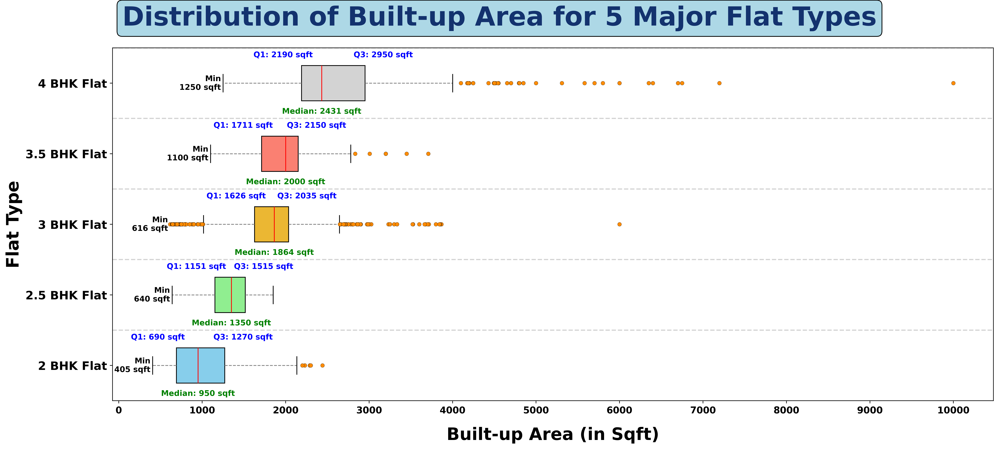

In [49]:
def Distribution_of_Builtup_Area_across_5_major_Flat_types():
    ## Preparing data for analysis:
    data = []
    five_maj_ft = ["2 BHK Flat", "2.5 BHK Flat", "3 BHK Flat",  "3.5 BHK Flat", "4 BHK Flat"]
    for i in five_maj_ft:
        data.append(df[(df['Flat'] == i) & 
                    (df['Built_up_area_in_sqft'] <= 10000)]['Built_up_area_in_sqft'].values)

    ## Creating plot: -------------------------------------------------------------------------------
    fig = plt.figure(figsize = (18,8), dpi = 500)
    ax = fig.add_subplot(1,1,1)
    box = ax.boxplot(data, vert = False, patch_artist=True)
    
    fig.suptitle("Distribution of Built-up Area for 5 Major Flat Types" , 
                  fontweight = 'bold', fontsize = 34, color = '#13326E', ha='center', x=0.5, y=1.0,
                 bbox={'facecolor': 'lightblue',     # Background color
                       'edgecolor': 'black',         # Border color
                       'boxstyle': 'round, pad=0.2', # Rounded box, with padding
                       'linewidth': 1                # Border thickness
                      })
    
    colors = ['skyblue', 'lightgreen', '#EBB733','salmon', 'lightgrey']
    
    for patch, color in zip(box['boxes'], colors):
        patch.set_facecolor(color)
        patch.set_edgecolor('black')
        patch.set_linewidth(1)
    
    ## Customize median lines
    for median in box['medians']:
        median.set_color('red')
        median.set_linewidth(1)
    
    ## Customize whiskers
    for whisker in box['whiskers']:
        whisker.set_linestyle('--')
        whisker.set_color('gray')
    
    ## Customize caps
    for cap in box['caps']:
        cap.set_color('black')
    
    ## Customize fliers (outliers)
    for flier in box['fliers']:
        flier.set(marker='o', markerfacecolor='darkorange', markersize=5, markeredgecolor='black',
        markeredgewidth=0.2)
    
    ## Annotate quantiles
    annot_info = []
    for i in range(len(data)):
        q1 = np.percentile(data[i], 25)
        q2 = np.percentile(data[i], 50)  # median
        q3 = np.percentile(data[i], 75)
        qmin = np.min(data[i])
        annot_info.append(tuple([i+1, q1, q2, q3, qmin]))
    
    for i, q1, q2, q3, qmin in annot_info:
        ax.text(qmin - 25, i, f'Min\n{int(qmin)} sqft', va='center', ha='right', color='black', fontweight='bold')
        ax.text(q1 - 220, i + 0.4, f'Q1: {int(q1)} sqft', va='center', ha='center', color='blue', fontweight='bold')
        ax.text(q2, i - 0.4, f'Median: {int(q2)} sqft', va='center', ha='center', color='green', fontweight='bold')
        ax.text(q3 + 220, i + 0.4, f'Q3: {int(q3)} sqft', va='center', ha='center', color='blue', fontweight='bold')
        plt.axhline(i + 0.5 , c='lightgrey', linestyle = '--')
    
    # Customize with Matplotlib
    ax.set_xlabel("Built-up Area (in Sqft)", fontsize=22, fontweight='bold', labelpad=15)
    ax.set_ylabel("Flat Type", fontsize=22, fontweight='bold')
    ax.set_yticks(list(range(1,len(five_maj_ft)+1)))
    ax.set_yticklabels(five_maj_ft , fontsize=15,  fontweight='bold')
    ax.set_xticks(np.arange(0,10001, 1000))
    ax.set_xticklabels(np.arange(0,10001, 1000), fontsize=12,  fontweight='bold')
    
    plt.tight_layout()
    plt.show()


Distribution_of_Builtup_Area_across_5_major_Flat_types()

### **`🔎 OBSERVATIONS`**
* **2 BHK Flats**: Built-up area ranges from ~400 to 2200 sqft, with a median around **950 sqft**.
* **2.5 BHK Flats**: Built-up area ranges from ~640 to 1900 sqft, with a median around **1350 sqft**.
* **3 BHK Flats**: Built-up area is widely spread (~600–5000 sqft) with a median around **1864 sqft**, showing **significant outliers**.
* **3.5 BHK Flats**: Median at **2000 sqft**, range narrower compared to 3 BHK.
* **4 BHK Flats**: Median at **2431 sqft**, but the spread is **very large** (1250–10,000 sqft), with **many outliers** beyond 4000 sqft.


### **`💡 Interpretation`**
* Built-up area scales logically with BHK type, though **variability increases** as the number of bedrooms increases.
* **2 BHKs are relatively standardized**, catering to compact housing demand.
* **3 BHKs and 4 BHKs show huge variance**, reflecting both mid-segment family apartments and luxury housing units.
* Presence of **extreme outliers in higher BHKs** suggests luxury projects or penthouse-style flats included in the dataset.


### **`🏠 Implication for Stakeholders`**
* **Homebuyers**:
  * 2 BHK buyers can expect consistency in built-up size.
  * Higher BHK buyers need to evaluate carefully, as size variation can drastically affect pricing and livability.
* **Developers**:
  * Demand segmentation is visible: compact standard units (2–2.5 BHK) vs high-variance luxury units (3–4 BHK).
  * **There is room to standardize offerings in 3 BHK & 4 BHK categories** to improve clarity and buyer confidence.
* **Investors**:
  * Large spread in 3–4 BHK built-up areas indicates **potential arbitrage opportunities** in undervalued luxury flats.
  * Outliers suggest presence of niche luxury markets—investment in such segments should be **cautious and selective**.

---

### **`📌 CONCLUSION :`**
The analysis highlights that Gurugram’s real estate market shows a **clear progression of built-up area with flat size**, but also **significant variability in higher BHK categories**, driven by luxury housing projects. This suggests a dual market—**standardized compact flats for the middle-class segment** and **highly variable large flats for premium buyers**. Stakeholders must consider these differences for decision-making, whether it’s buying, developing, or investing.

<br><br>

---
---
# **`II. 📍 Sector :`**

**Gurugram** (formerly Gurgaon) is divided into **SECTORS**, each planned as a **self-sustaining urban pockets** with residential, commercial, and mixed-use developments. **These sectors differ widely in** terms of **infrastructure, connectivity, property pricing, and lifestyle offerings**.
* **New Gurugram (Sectors 81–95, 102–115):** Emerging residential hubs with large townships, modern apartments, and growing infrastructure. Popular among **young professionals and first-time homebuyers**.
* **Golf Course Road & Extension (Sectors 42–67):** Premium residential and commercial belt with luxury apartments, high-end offices, and malls. Known as **one of the costliest areas** of Gurugram.
* **Dwarka Expressway Belt (Sectors 99–115):** Fast-developing corridor with affordable-to-mid segment housing. Strong future potential due to proximity to Delhi and upcoming **Dwarka Expressway connectivity**
* **MG Road & Central Gurugram (Sectors 14, 15, 29, 30):** Established zones with mix of **old residential colonies, commercial hubs, and malls**. Good connectivity, but crowded compared to newer sectors.
* **Southern Peripheral Road (SPR) Belt (Sectors 68–75):** Emerging IT and commercial hub with new residential projects. Attracts **working professionals in corporate parks nearby**.
* **Old Gurgaon (Sectors 4–12, Palam Vihar, etc.):** Traditional residential areas with independent houses, local markets, and established social infrastructure. Lower property prices compared to new sectors.

#### 📌 INSHORT:
**Gurugram’s sectors show a dual character**: older sectors with established infrastructure and **affordable living**, and newer sectors positioned as **premium or growth corridors**. This diversity makes Gurugram attractive for a wide range of stakeholders—from affordable housing buyers to luxury seekers and long-term investors.

<br>

---
# **`A.` What all Sectors have Flats available for Sale?**

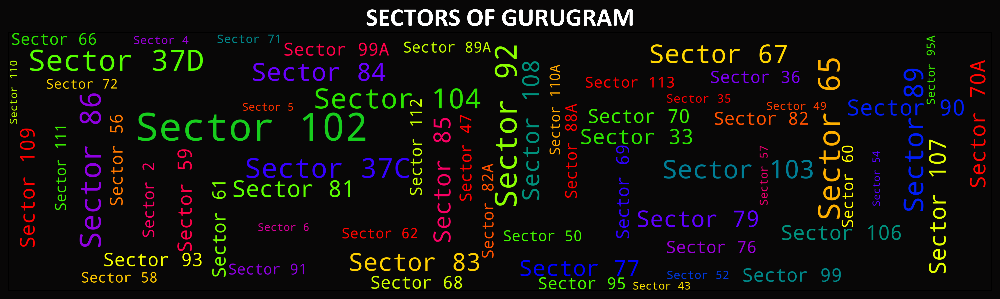

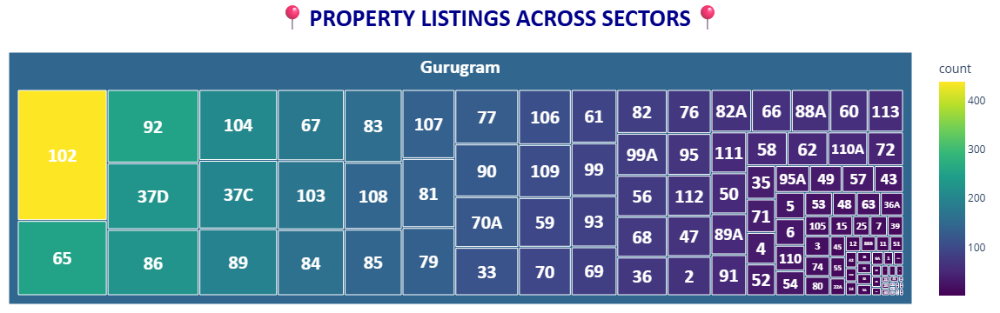

In [151]:
def What_all_Sectors_have_Flats_available_for_Sale():
    ## Preparing data for analysis:
    data = df[df['Sector'] != '-']
    data = pd.DataFrame(data["Sector"].value_counts()).reset_index()
    
    ## Creating plot: --------------------------------------------------------------------------------
    fig = plt.figure(figsize = (12, 4), dpi = 500)
    ax = fig.add_subplot(1,1,1)
    
    wc = WordCloud(width=3800, height=1000, background_color="#080707",
                   colormap="prism",             # color palette
                   contour_color="black",          # outline color
                   contour_width=10,                # outline thickness
                   max_words=800,                  # limit words
                   max_font_size=150,               # largest word size
                   min_font_size=40,               # smallest word size
                   prefer_horizontal=0.5,          # orientation of words
                   random_state=32,                # reproducibility
                  )
    wc.generate_from_frequencies(data.set_index("Sector")["count"].to_dict())
    
    ax.imshow(wc, interpolation="bilinear")
    ax.set_title('SECTORS OF GURUGRAM', fontsize=22, fontweight='bold', color='white', fontfamily='Calibri')

    ax.set_xticks(range(0))
    ax.set_yticks(range(0))
    for spline in ['top', 'bottom', 'left', 'right']:
        ax.spines[spline].set_color('#000000')
    
    fig.patch.set_facecolor("#080707")   # figure background
    ax.set_facecolor("#080707")
    fig.tight_layout()
    
    plt.show()

   
    ## Creating a TREEMAP for Sector Frequency: -------------------------------------------------------------
    data['Sector'] = data["Sector"].apply(lambda x: x.split()[-1])
    
    fig = px.treemap(data, path=[px.Constant('Gurugram'),'Sector'], 
                     values = 'count', color = 'count' , color_continuous_scale='viridis'  )
    
    fig.update_layout(autosize=True, margin=dict(l=10, r=10, t=60, b=10),
                      title=dict(text="<b>📍PROPERTY LISTINGS ACROSS SECTORS📍</b>",
                                 font=dict(size=28, color="darkblue", family='Calibri'),
                                 x = 0.5, pad=dict(t=50, b=0, l=20, r=20)), paper_bgcolor='white')
    
    fig.update_traces(textinfo="label",
                      hovertemplate='<b>Sector %{label}</b><br>Property Count: %{value}<br>City: %{parent}<extra></extra>',
                      textfont=dict(size=22, color="white", family="Calibri black"),
                      textposition="middle center",
                      tiling=dict(pad=2),  # extra padding between boxes
                     )
    
    fig.show()


What_all_Sectors_have_Flats_available_for_Sale()

### **`🔍 OBSERVATIONS :`**
* Sector **102** has the **highest number of property listings**, standing out prominently in both the word cloud and treemap.
* **Other sectors with significant listings** include **65, 92, 104, 37D, 86, 83, 67, 37C, 89, and 103**.
* Many sectors (e.g., 48, 36A, 6) have very limited listings, as shown by their smaller boxes in the treemap and smaller word sizes.
* **Property listings are not evenly distributed** — instead, they are **concentrated in specific high-demand or high-development corridors**.

### **`💡 Interpretation`**
* The **clustering of high property listings** in certain sectors indicates **ongoing real estate development projects** and **stronger buyer/seller interest in these areas**.
* Popular sectors like **102, 92, 104, 65** are likely hubs of **residential demand** due to proximity to major roads, infrastructure projects, and better livability and amenity indices.
* **Sectors with lower listings** may represent **emerging or underdeveloped localities**, possibly due to incomplete infrastructure or limited real estate activity.

### **`🎯 Implications for Stakeholders`**
* **Buyers/Investors**: High-listing sectors may provide **more options** and **competitive pricing**, but also signal high demand and potentially rising property prices.
* **Sellers/Developers**: Concentrated listings in specific sectors suggest these areas are **attractive markets for new projects**. However, **oversupply risks should be considered**.
* **Policy Makers/Urban Planners**: Uneven distribution highlights the **need for balanced infrastructure development** across Gurugram to **avoid excessive pressure on specific sectors**.

---

### **`📌 CONCLUSION :`**
The analysis of property listings across Gurugram reveals that **real estate activity is heavily skewed** **towards certain sectors** such as **102, 92, and 65**, marking them as **prime hotspots**. This **concentration reflects** both **market demand and developmental focus**, but also ***underscores the need to monitor oversupply risks***. For buyers, these sectors offer variety and liquidity, while developers and policymakers must balance growth across emerging areas to sustain Gurugram’s real estate ecosystem.

<br><br>

---
# **`B.` Distribution of 5 Major Flat Types across Sectors of Gurugram.**
- Which Sectors provide major chunk of a particular Flat type?
- Are there Sectors which provide all kind of Flats?
- Are there Sectors which offer only a particular kind of Flat? 

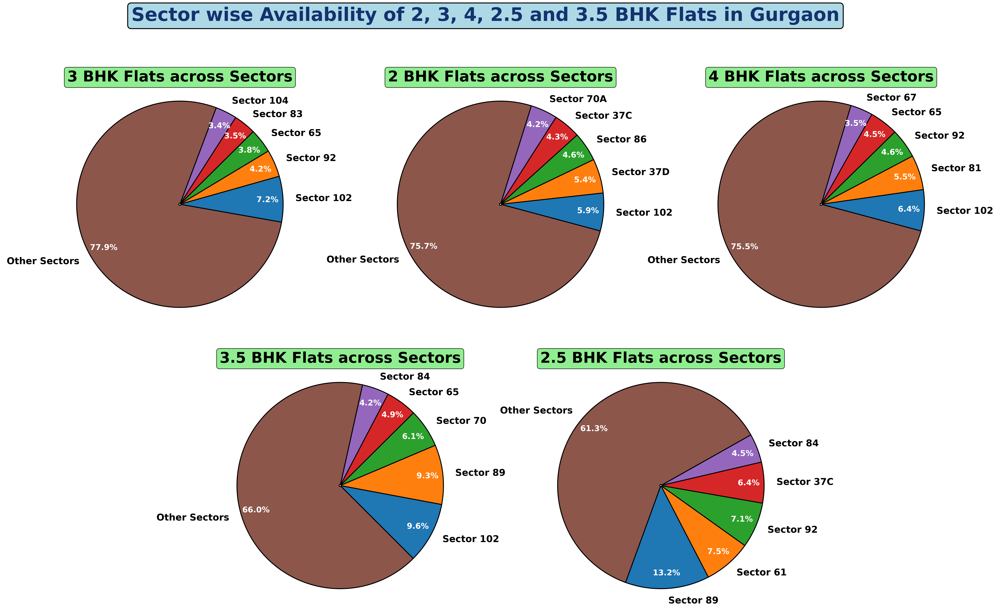

In [39]:
def Distribution_of_5_Major_Flat_Types_across_Sectors_of_Gurugram():
    ## Preparinf data for analysis:
    data_3BHK = pd.concat([df[df['Flat'] == '3 BHK Flat']['Sector'].value_counts().drop('-').head(5) ,
                           pd.Series([df[df['Flat'] == '3 BHK Flat']['Sector'].value_counts().drop('-')[5:].sum()] ,
                                     index=['Other Sectors'])])
    
    data_2BHK = pd.concat([df[df['Flat'] == '2 BHK Flat']['Sector'].value_counts().drop('-').head(5) ,
                           pd.Series([df[df['Flat'] == '2 BHK Flat']['Sector'].value_counts().drop('-')[5:].sum()] ,
                                     index=['Other Sectors'])])
    
    data_4BHK = pd.concat([df[df['Flat'] == '4 BHK Flat']['Sector'].value_counts().drop('-').head(5) ,
                           pd.Series([df[df['Flat'] == '4 BHK Flat']['Sector'].value_counts().drop('-')[5:].sum()] ,
                                     index=['Other Sectors'])])
    
    data_3_5BHK = pd.concat([df[df['Flat'] == '3.5 BHK Flat']['Sector'].value_counts().drop('-').head(5) ,
                           pd.Series([df[df['Flat'] == '3.5 BHK Flat']['Sector'].value_counts().drop('-')[5:].sum()] ,
                                     index=['Other Sectors'])])
    
    data_2_5BHK = pd.concat([df[df['Flat'] == '2.5 BHK Flat']['Sector'].value_counts().drop('-').head(5) ,
                           pd.Series([df[df['Flat'] == '2.5 BHK Flat']['Sector'].value_counts().drop('-')[5:].sum()] ,
                                     index=['Other Sectors'])])

    ## Creating plot: --------------------------------------------------------------------------------
    fig = plt.figure(figsize = (18, 10), dpi=500)
    ax1 = fig.add_subplot(2, 6, (1,2))
    ax2 = fig.add_subplot(2, 6, (3,4))
    ax3 = fig.add_subplot(2, 6, (5,6))
    ax4 = fig.add_subplot(2, 6, (8,9))
    ax5 = fig.add_subplot(2, 6, (10,11))
    
    fig.suptitle("Sector wise Availability of 2, 3, 4, 2.5 and 3.5 BHK Flats in Gurgaon" , 
                  fontweight = 'bold', fontsize = 20, color = '#13326E', ha='center', x=0.50, y=1,
                 bbox={'facecolor': 'lightblue',     # Background color
                       'edgecolor': 'black',         # Border color
                       'boxstyle': 'round, pad=0.2', # Rounded box, with padding
                       'linewidth': 1                # Border thickness
                      })
    
    box_sepcs={'facecolor': 'lightgreen','edgecolor': 'black','boxstyle': 'round, pad=0.2','linewidth': 0.5}
    
    wedges, texts, autotexts = ax1.pie(x = data_3BHK, labels = data_3BHK.index , autopct='%0.1f%%', 
                                       startangle = -10, pctdistance=0.85, labeldistance = 1.12, radius=1.1,            
                                       wedgeprops ={'linewidth':1 , 'edgecolor':'black', 'width':1.089})
    for t in texts:
        t.set_fontsize(10)
        t.set_color('black')
        t.set_fontweight('bold')
    
    for at in autotexts:
        at.set_fontsize(8.5)
        at.set_fontweight('bold')
        at.set_color('white')
    
    ax1.set_title('3 BHK Flats across Sectors', fontsize=16, fontweight='bold', bbox = box_sepcs)
    
    wedges, texts, autotexts = ax2.pie(x = data_2BHK, labels = data_2BHK.index , autopct='%0.1f%%', 
                                       startangle = -15, pctdistance=0.85, labeldistance = 1.12, radius=1.1,            
                                       wedgeprops ={'linewidth':1 , 'edgecolor':'black', 'width':1.089})
    for t in texts:
        t.set_fontsize(10)
        t.set_color('black')
        t.set_fontweight('bold')
    
    for at in autotexts:
        at.set_fontsize(8.5)
        at.set_fontweight('bold')
        at.set_color('white')
    
    ax2.set_title('2 BHK Flats across Sectors', fontsize=16, fontweight='bold', bbox = box_sepcs)
    
    
    wedges, texts, autotexts = ax3.pie(x = data_4BHK, labels = data_4BHK.index , autopct='%0.1f%%', 
                                       startangle = -15, pctdistance=0.85, labeldistance = 1.12, radius=1.1,            
                                       wedgeprops ={'linewidth':1 , 'edgecolor':'black', 'width':1.089})
    for t in texts:
        t.set_fontsize(10)
        t.set_color('black')
        t.set_fontweight('bold')
    
    for at in autotexts:
        at.set_fontsize(8.5)
        at.set_fontweight('bold')
        at.set_color('white')
    
    ax3.set_title('4 BHK Flats across Sectors', fontsize=16, fontweight='bold', bbox = box_sepcs)
    
    wedges, texts, autotexts = ax4.pie(x = data_3_5BHK, labels = data_3_5BHK.index , autopct='%0.1f%%', 
                                       startangle = -45, pctdistance=0.85, labeldistance = 1.12, radius=1.1,            
                                       wedgeprops ={'linewidth':1 , 'edgecolor':'black', 'width':1.089})
    for t in texts:
        t.set_fontsize(10)
        t.set_color('black')
        t.set_fontweight('bold')
    
    for at in autotexts:
        at.set_fontsize(8.5)
        at.set_fontweight('bold')
        at.set_color('white')
    
    ax4.set_title('3.5 BHK Flats across Sectors', fontsize=16, fontweight='bold', bbox = box_sepcs)
    
    wedges, texts, autotexts = ax5.pie(x = data_2_5BHK, labels = data_2_5BHK.index , autopct='%0.1f%%', 
                                       startangle = -110, pctdistance=0.85, labeldistance = 1.12, radius=1.1,            
                                       wedgeprops ={'linewidth':1 , 'edgecolor':'black', 'width':1.089})
    for t in texts:
        t.set_fontsize(10)
        t.set_color('black')
        t.set_fontweight('bold')
    
    for at in autotexts:
        at.set_fontsize(8.5)
        at.set_fontweight('bold')
        at.set_color('white')
    
    ax5.set_title('2.5 BHK Flats across Sectors', fontsize=16, fontweight='bold', bbox = box_sepcs)
    
    
    plt.show()


Distribution_of_5_Major_Flat_Types_across_Sectors_of_Gurugram()

### **`🔍 OBSERVATIONS :`**
* **Certain sectors consistently appear among the top contributors:**
  * **Sector 102**: Significant share across **2, 3, 3.5, and 4 BHK** flats.
  * **Sector 65, 92, 83, 37D, and 37C**: Regular contributors to availability across different BHK types.
* **2.5 BHK flats** show a **more concentrated distribution compared to other Flat types**, with **Sector 89 (13.2%)** standing out strongly.
* **3.5 BHK flats** have **slightly less skewed distribution compared to 2/3/4 BHK**, as Sectors other than top 5 contribute relatively less (66%).


### **`💡 Interpretation`**
* The strong presence of **Sector 102** across multiple flat types indicates it is a **real estate hotspot** ***with diversified offerings***.
* **Flat availability is widely spread across the sectors**, but **specific high-demand nodes** (102, 65, 92, 89) are shaping the market.
* The **unique case of Sector 89 for 2.5 BHKs** suggests **localized development projects** specifically **targeting this segment**.
* **Higher BHKs (3.5 & 4) appear in premium clusters (65, 67, 81, 92)**, aligning with upscale housing demand.


### **`🎯 Implication for Stakeholders`**
* **Buyers/Investors**:
  * **Sector 102** offers diverse options, making it **attractive for different buyer segments**.
  * Niche markets like **Sector 89 for 2.5 BHKs** may present good investment opportunities.
* **Developers/Sellers**:
  * **Strong availability in 102 and 65 suggests** these are **established competitive zones**, requiring differentiation (amenities, pricing).
  * Lower visibility of certain sectors in specific BHKs could mean **untapped opportunities** for targeted development.
* **Policy Makers/Urban Planners**:
  * **Uneven concentration highlights** a **need to balance infrastructure** to avoid congestion in over-represented areas (like 102).
  * Encouragement of growth in underrepresented sectors can help reduce real estate imbalance.

---

### **`📌 CONCLUSION :`**
The analysis shows that **while flat availability is widely distributed across Gurugram**, **certain sectors** like **102, 65, 92, and 89** stand out as **key real estate nodes**. Sector 102 emerges as the most versatile, hosting a significant share across almost all BHK categories. **For buyers, this ensures variety and liquidity, while developers must innovate in these competitive hotspots.** Policymakers should focus on spreading growth evenly to ensure sustainable urban development in Gurugram.

<br><br>

---
# **`C.` Which Sectors are best in providing Amenities?**
- Does amenities uniformly distributed across Sectors?
- Are there sectors with good and sectors with poor amenities?


**`NOTE:`** 
- To assess Amenities across Sectors, we can use **Sector Amenity Score** Feature added during Feature Engineering step.
- Sector Amenity Score is awarded **based on number of key amenities falling withtin 2.5 KM of Sector Centroid**.

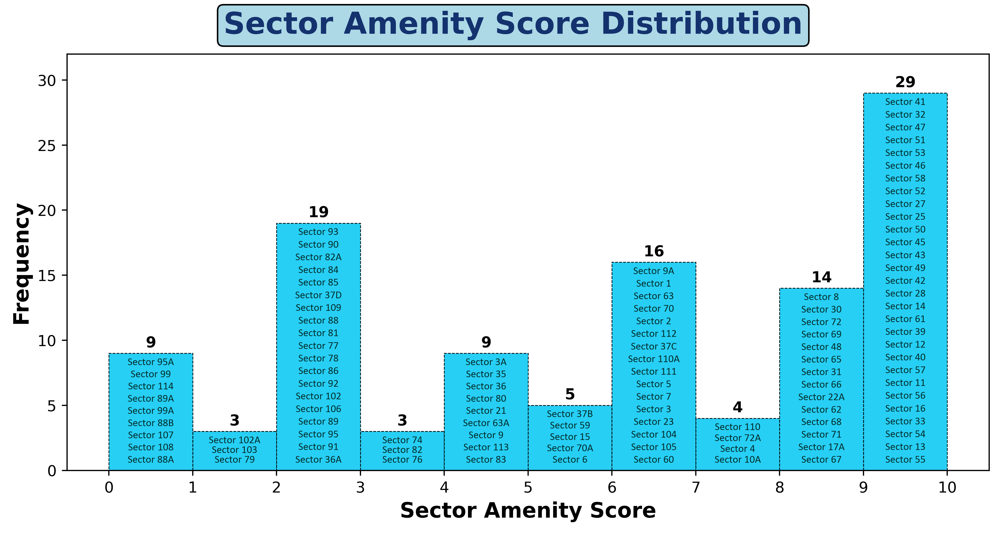

In [234]:
def Which_Sectors_are_best_in_providing_Amenities():
    ## Preparing data for analysis:
    sec_amen_score = df[~ df['Sector'].duplicated()][['Sector', 'Sector_Amenity_Score']]
    sec_amen_score = sec_amen_score[sec_amen_score['Sector'] != '-'].reset_index(
        drop=True).sort_values(by='Sector_Amenity_Score', ascending = False)

    ## Creating Plot: --------------------------------------------------------------------------------
    fig = plt.figure(figsize = (11,5), dpi=500)
    ax = fig.add_subplot(1,1,1)
    
    fig.suptitle("Sector Amenity Score Distribution" , 
                  fontweight = 'bold', fontsize = 20, color = '#13326E', ha='center', x=0.50, y=0.96,
                 bbox={'facecolor': 'lightblue',     # Background color
                       'edgecolor': 'black',         # Border color
                       'boxstyle': 'round, pad=0.2', # Rounded box, with padding
                       'linewidth': 1                # Border thickness
                      })
    
    counts, bins, patches = ax.hist(sec_amen_score['Sector_Amenity_Score'], bins = 10, color = '#27CFF5',
                                   edgecolor='black', linewidth=0.5, linestyle='--')
    
    ax.bar_label(patches, labels = np.array(counts).astype('int8'), padding=2, 
                 fontsize=10, color='black',fontweight='bold')
    ax.set_xlabel('Sector Amenity Score', fontsize=14, fontweight='bold')
    ax.set_ylabel('Frequency', fontsize=14, fontweight='bold')
    ax.set_ylim(0,32)
    ax.set_xticks(np.linspace(0,10,11))
    ax.set_xticklabels(np.linspace(0,10,11).astype('int8') , fontsize=10)
    
    # Annotate Sector Names:
    for bin, i, count in zip(list(range(10)), np.linspace(0.5, 9.5, 10), counts.astype('int8')):
        if bin < 9:
            lis_sectors = sec_amen_score[sec_amen_score['Sector_Amenity_Score'].between(bin, bin+1, 
                                                                                        inclusive='left'
                                                                                       )]['Sector'].values
        else:
            lis_sectors = sec_amen_score[sec_amen_score['Sector_Amenity_Score'].between(bin, bin+1, 
                                                                                        inclusive='both'
                                                                                       )]['Sector'].values
            
        for j, sector in zip(np.linspace(count-0.7, 0.8, count) , lis_sectors):
            ax.text(i, j, f'{sector}', va='center', ha='center', color='#042F2D', 
                    fontsize=7, fontfamily='calibri')
    
    plt.show()


Which_Sectors_are_best_in_providing_Amenities()

### **`🔍 OBSERVATIONS :`**
* The **Sector Amenity Score distribution** shows a **wide spread**, with **values ranging from 0 to 10**.
* The **highest frequency** is between **score 9 to 10 (29 sectors)**, followed by **score 2 to 3 (19 sectors)** and **score 6 to 7 (16 sectors)**.
* Very few sectors fall at **score 1-2 (3 sectors)** and **score 3-4 (3 sectors)**.
* Moderate clustering is seen around **scores 4-5, 5-6, 7-8, and 8-9**, each having between 4–14 sectors.
* A **significant chunk of sectors (29)** have **achieved** the **amenity score between 9 to 10**, indicating **strong presence of amenities in those regions**.


### **`💡 Interpretation`**
* The data suggests a **polarized distribution**:
  * A **large number of sectors** have **very high scores (8-10)**, meaning they are rich in amenities.
  * A **non-trivial number of sectors** have **low scores (0–2)**, highlighting ***underdeveloped areas***.
* The **uneven distribution hints** at **unequal development** across Gurugram sectors.
* The concentration at **higher scores may indicate premium housing clusters** with **good urban infrastructure**.
* Sectors with **very low scores** may either be **newly developing** or **less prioritized** in terms of urban planning.


### **`🎯 Implication for Stakeholders`**
* **Homebuyers/Investors**:
  * Sectors with **score 8-10** are prime for **luxury housing and immediate livability**.
  * Low-score sectors may offer **cheaper investment opportunities** with **potential for future growth**.
* **Developers/Builders**:
  * Can focus on **low-scoring sectors (0–2)** to **bridge the amenity gap** and **attract new demand**.
  * **High-scoring sectors** are already competitive; **differentiation must come through pricing, branding, or niche amenities**.
* **Policy Makers/Urban Planners**:
  * The **gap** between high-amenity and low-amenity sectors **suggests** a **need for balanced urban development**.
  * Investments in infrastructure for **underdeveloped sectors** can reduce real estate inequality and drive sustainable city growth.

---

### **`📌 CONCLUSION :`**
The analysis highlights a **polarized amenity landscape in Gurugram**, where a **large number of sectors excel in amenities while a significant minority lag far behind**. For stakeholders, this means balancing **short-term opportunities in high-scoring areas** with **long-term growth potential in underdeveloped sectors**. Policymakers and developers must work together to ensure inclusive development across all sectors.

<br><br>

---
# **`D.` Which Sectors are expensive and which are economical to buy?** (using Sector-wise Median Price Density)

#### **`✅ Why "Median Property Cost per Sq.ft" is More Comparable than other Property Metrics:`**
+ **Robust to Outliers**
  * Real estate **data often has extreme values** (luxury penthouses, very cheap distress sales).
  * **Median** ***reduces their influence***, showing the “typical” cost per sqft better than **mean**.
+ **Standardized Measure**
  * Comparing per sq.ft cost **removes distortions caused by property size**.
  * For example: A ₹1 Cr flat of 500 sqft vs. ₹1 Cr villa of 2500 sqft — their total prices are same, but cost per sqft reveals affordability differences.
+ **Better Cross-Locality Comparison**
  * Localities differ in property sizes and mix (2 BHK vs 5 BHK).
  * Median per sq.ft cost **allows fairer comparison** by ***focusing on price density, not absolute property price***.


#### **`⚠️ How Other Property Metrics Can Be Misleading :`**
+ **Mean Property Price (Absolute Value)**
  * **Skewed by luxury projects** or **large villas**, giving a false sense of affordability.
  * Example: Locality A has 10 flats around ₹50L, but 1 villa at ₹10 Cr → mean shoots up unrealistically.
+ **Mean Property Price per Sq.ft**
  * Still **influenced by outliers** — one ultra-expensive luxury apartment can distort the average.
+ **Median Absolute Price**
  * **Does not account for varying sizes**.
  * A ₹50L 1 BHK vs. ₹50L 3 BHK are treated the same, even though their per sq.ft costs (and affordability) differ drastically.
+ **Mode (Most Frequent Price)**
  * Often misleading if property prices are fragmented — different developers, project types, or amenities. Rarely useful for decision-making.
+ **Range (Min–Max Prices)**
  * **Too broad to be meaningful**.
  * In most localities, cheapest vs. costliest properties differ by **5–10x**.


#### **`🎯 IN SHORT:`**
- **Median Property Cost per Sq.ft** is the **most reliable and comparable metric** for **cross-locality property price analysis** because it:
  * Neutralizes outliers
  * Standardizes for property size
  * Reflects the central tendency of prices in a locality

Other metrics like **mean** or **absolute median prices** can be misleading as they hide affordability nuances and distort comparisons.

---

### Let's see:
+ Does the distribution of Median Property Price/Sq.ft across Sectors skewed?
+ Are some Sectors expensive then others?
+ Can we come with a segmentation criteria for Sectors based on Median Property Price/Sq.ft?

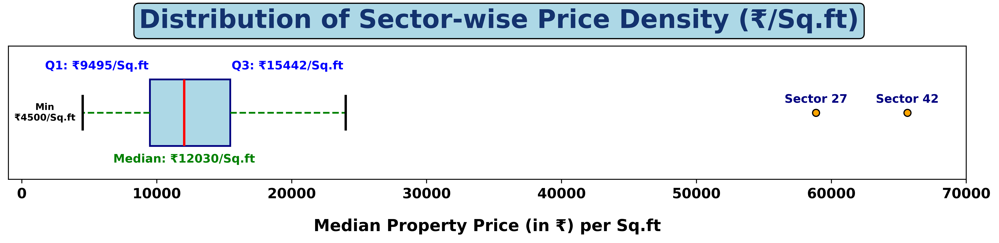

In [92]:
def Which_Sectors_are_expensive_and_which_are_economical_to_buy():
    ## Preparing data for anlaysis:
    data = df[df['Sector'] != '-']
    data = data.groupby(by='Sector')[['Avg_price_rupee_per_sqft']].agg({'Avg_price_rupee_per_sqft':'median'
                                                                     })
    sec_pri_per_sqft = data['Avg_price_rupee_per_sqft']
    
    ## Creating plot: -----------------------------------------------------------------------------------
    fig = plt.figure(figsize = (12,3), dpi = 500)
    ax = fig.add_subplot(1,1,1)
    box = ax.boxplot(sec_pri_per_sqft, vert = False, patch_artist=True, widths = [0.5],
                    boxprops=dict(facecolor="lightblue", color="navy", linewidth=1.5),
                    whiskerprops=dict(color="green", linewidth=1.5, linestyle='--'),
                    capprops=dict(color="black", linewidth=2),     # top/bottom caps
                    medianprops=dict(color="red", linewidth=2),    # median line
                    flierprops=dict(marker='o', markerfacecolor="orange", markersize=6, linestyle="none"))
    
    fig.suptitle("Distribution of Sector-wise Price Density (₹/Sq.ft)" , 
                  fontweight = 'bold', fontsize = 22, color = '#13326E', ha='center', x=0.5, y=0.95,
                 bbox={'facecolor': 'lightblue',     # Background color
                       'edgecolor': 'black',         # Border color
                       'boxstyle': 'round, pad=0.2', # Rounded box, with padding
                       'linewidth': 1                # Border thickness
                      })
    
    ## Annotation of Quartiles:
    q1 = np.percentile(sec_pri_per_sqft.values, 25)
    q2 = np.percentile(sec_pri_per_sqft.values, 50)  # median
    q3 = np.percentile(sec_pri_per_sqft.values, 75)
    qmin = np.min(sec_pri_per_sqft.values)
    
    ax.text(qmin - 2800, 1, f'Min\n₹{int(qmin)}/Sq.ft', va='center', ha='center', color='black', 
            fontweight='bold', fontsize=8)
    ax.text(q1 - 100, 1 + 0.35, f'Q1: ₹{int(q1)}/Sq.ft', va='center', ha='right', color='blue', 
            fontweight='bold')
    ax.text(q2, 1 - 0.35, f'Median: ₹{int(q2)}/Sq.ft', va='center', ha='center', color='green', 
            fontweight='bold')
    ax.text(q3 + 100, 1 + 0.35, f'Q3: ₹{int(q3)}/Sq.ft', va='center', ha='left', color='blue', 
            fontweight='bold')
    
    ## Marking outliers:
    out = sec_pri_per_sqft[sec_pri_per_sqft > 55000]
    
    for sector, pri in zip(out.index, out.values):
        ax.text(pri, 1 + 0.1, f'{sector}', va='center', ha='center', color='navy', fontweight='bold')
    
    # Customize with Matplotlib
    ax.set_xlabel("Median Property Price (in ₹) per Sq.ft", fontsize=14, fontweight='bold', labelpad=15)
    ax.get_yaxis().set_visible(False) 
    ax.set_xlim(-1000, 70000)
    ax.set_xticks(list(np.linspace(0,70000, 8)))
    ax.set_xticklabels(np.linspace(0,70000, 8).astype('int32') , fontsize=12,  fontweight='bold')
    
    plt.tight_layout()
    plt.show()


Which_Sectors_are_expensive_and_which_are_economical_to_buy()

## **`🔍 OBSERVATION :`**  
* The **median property price per sq.ft across sectors** is around **₹12,030**.
* The **interquartile range (IQR)** lies between **₹9,495 (Q1)** and **₹15,442 (Q3)**.
* The **minimum sector median price density** observed is around **₹4,500/sq.ft**.
* Two **extreme outliers** (Sector 27 and Sector 42) show prices in the range of **₹58,000–₹66,000/sq.ft**, far above the rest.
* **Most sectors are tightly concentrated within** the **₹9K–₹15K band**.
* **NOTE:** Sector 27 and 42 are outliers in data cause all the property listed in Sector 42 are DLF Properties which are usually Premium high-end luxurious properties and Sector 27 has only 1 property listing.


## **`💡 Interpretation`**
* The distribution indicates that **a majority of sectors fall into a mid-price band**, with prices clustering around the central ₹12K/sq.ft value.
* The presence of **very high-value outliers** (Sector 27, Sector 42) suggests that certain sectors command a huge premium, possibly due to **prime location, luxury projects, or commercial significance**. 
* The **lower bound of ₹4,500/sq.ft** shows that **affordable sectors still exist**, though they are fewer compared to mid-range and premium ones.
* The data is **right-skewed**, because of the presence of extreme high-price outliers that pull the upper range further out.


## **`🎯 Implication for Stakeholders`**
* **Homebuyers / Investors**: Can benchmark affordability — most livable/mid-market options are between ₹9K–₹15K/sq.ft, while Sectors 42 represent ultra-premium market.
* **Developers**: Mid-segment housing demand is likely concentrated in the ₹9K–₹15K/sq.ft bracket. However, niche demand exists in ultra-premium zones.
* **Policy Makers / Urban Planners**: Need to be aware of high price disparities across sectors. Affordable housing policies may be directed toward sectors closer to the lower quartile.
* **Real Estate Agents**: Can use this segmentation to position properties (Affordable <₹9K, Mid-range ₹9K–15K, Premium >₹15K, Ultra-luxury outliers).

---

## **`✅ CONCLUSION :`**
The distribution of sector-wise property density shows a **clear concentration around mid-market pricing**, with a handful of outlier sectors commanding exceptionally high values. This highlights Gurgaon’s **diverse housing market** — ranging from affordable zones to globally benchmarked luxury hubs. **Segmenting sectors on this price density helps in better targeting of buyers, investment decisions, and policy design**.

---

### ❓ Additional Questions:
**Q1. Does the distribution of Median Property Price/Sq.ft across Sectors skewed?**<br>
➡️ Yes, the distribution is **right-skewed** due to a few ultra-expensive sectors (like Sector 42) that lie far beyond the bulk of data.

**Q2. Are some Sectors expensive than others?**<br>
➡️ Absolutely. While most sectors fall in the **₹9K–15K/sq.ft range**, outliers like **Sector 42** are significantly more expensive, showing 4–6x higher median prices compared to the city’s central tendency.

---

<br>

## **`Segmentation of Sectors based on "Affordability of Sector"`**
- Sectors can be segmented using Sector-wise Price Density (₹/Sq.ft). ⚠️ But there exist some drawbacks:
    + **Relative, not absolute** - Quartiles only show relative positioning. A "Premium" sector in one dataset might actually be "Moderate" if compared with updated dataset.
    + **Sensitive to outliers in data** - Few ultra-expensive sectors may stretch Q3 and max and some Cheap outliers can also pull Q1 down.
    + **Unequal category meaning** - E.g., Q3–Max might span ₹12,000–₹40,000, a huge jump compared to Q1–Q2.


#### **✅ Possible Alternatives / Enhancements**
* **Use Fixed Thresholds** (e.g., <₹5,000/sq.ft = affordable, ₹5,000–8,000 = mid-range, >₹8,000 = premium) — aligns better with how buyers/sellers think.
* **Combine Quartiles + Domain Knowledge** — use box plot to explore spread, but set thresholds based on market understanding (e.g., luxury zones).
* **Clustering (K-Means / Hierarchical)** — unsupervised clustering on price per sq.ft (and maybe amenities score) may reveal more natural groupings.


#### 🥧 **CONCLUSION**: 
Quartile segmentation is a good **first-pass EDA tool** for relative comparisons, but for real-world stakeholder insights, it’s better to supplement it with **absolute price thresholds or clustering** to avoid misleading labels.

---
### **Lets Cluster Sectors based on Sectro-wise Price Density (₹/Sq.ft)**

In [146]:
from sklearn.cluster import KMeans

## Preparing data for segmentation:
data = df[df['Sector'] != '-']
data = data.groupby(by='Sector')[['Avg_price_rupee_per_sqft']].agg({'Avg_price_rupee_per_sqft':'median'})
data = data[data['Avg_price_rupee_per_sqft'] <= 25000]  ## Keeping outliers out of clustering...

## Aplying K-Means CLustering:
kmeans = KMeans(n_clusters=4, random_state=21)
data['Segment'] = kmeans.fit_predict(data[['Avg_price_rupee_per_sqft']])

## Lets analyse clusters:
for i in range(4):
    temp = data[data['Segment'] == i]
    print(f"Cluster Number: {i}", "Min :₹", temp.min()[0], "; Max :₹", temp.max()[0], 
          "Total Sector Count: ", temp.shape[0])

Cluster Number: 0 Min :₹ 4500.0 ; Max :₹ 8565.0 Total Sector Count:  17
Cluster Number: 1 Min :₹ 12750.0 ; Max :₹ 17190.0 Total Sector Count:  29
Cluster Number: 2 Min :₹ 17755.0 ; Max :₹ 24000.0 Total Sector Count:  17
Cluster Number: 3 Min :₹ 8850.0 ; Max :₹ 12500.0 Total Sector Count:  46


<br>

#### **`Sector Segmentation Criteria :`**
- Final Sector Segmentation based on Market Research and Data observed above.
- **Sectors with Median Price Density:**
    + Less than ₹8,500/Sq.ft -> `AFFORDABLE`
    + ₹8,500/Sq.ft to ₹12,500/Sq.ft -> `MID-RANGE`
    + ₹12,500/Sq.ft and ₹17,000/Sq.ft -> `EXPENSIVE`
    + More than ₹17,000/Sq.ft -> `LUXURY`

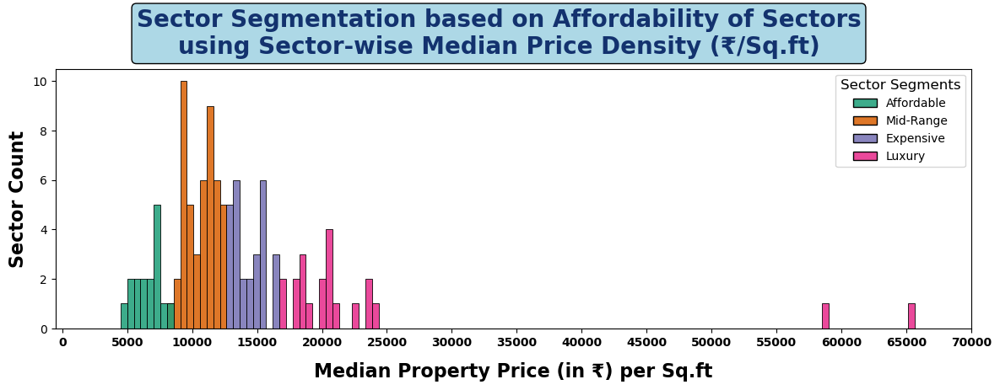

In [344]:
## Creating a New Categorical Feature for "Affordability of Sector" -> 'Sector_segment':
data = df[df['Sector'] != '-']
data = data.groupby(by='Sector')[['Avg_price_rupee_per_sqft']].agg({'Avg_price_rupee_per_sqft':'median'})

def segmentation(value):
    if value <= 8500:
        return 'Affordable'
    elif 8500 < value  and value <= 12500:
        return 'Mid-Range'
    elif 12500 < value and value <= 17000:
        return 'Expensive'
    else:
        return 'Luxury'

data['Sector_segment'] = data['Avg_price_rupee_per_sqft'].apply(segmentation)


## Plotting Histogram with obtained Clusters:
def Sector_Segmentation_histogram(data):
    fig = plt.figure(figsize = (14,4))
    ax = fig.add_subplot(1,1,1)
    fig.suptitle("Sector Segmentation based on Affordability of Sectors\nusing Sector-wise Median Price Density (₹/Sq.ft)" , 
                      fontweight = 'bold', fontsize = 20, color = '#13326E', ha='center', x=0.5, y=1.06,
                     bbox={'facecolor': 'lightblue',  'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 
                           'linewidth': 1})
    
    sns.histplot(data=data, x='Avg_price_rupee_per_sqft', hue='Sector_segment', ax = ax, legend = True,
                 alpha=0.85, bins = 120, hue_order = ['Affordable', 'Mid-Range', 'Expensive', 'Luxury'],
                palette='Dark2')
    
    ax.set_xlabel("Median Property Price (in ₹) per Sq.ft", fontsize = 16, fontweight = 'bold', labelpad = 12)
    ax.set_ylabel("Sector Count", fontsize = 16, fontweight = 'bold')
    
    ax.set_xlim(-500, 70000)
    ax.set_xticks(list(range(0, 70001, 5000)))
    ax.set_xticklabels(list(range(0, 70001, 5000)), fontsize = 10, fontweight = 'bold')
    
    ax.legend_.set_title('Sector Segments', prop={'size':12})
    plt.show()

Sector_Segmentation_histogram(data)

### `Since the Sector Segmentation is based on Market Research and historical data, we can include the "Sector_Segment" Feature in main Dataframe and use it for further analysis and Future Modelling.`

In [341]:
## Adding "Sector_Segment" to main Dataframe 'df':
df.insert(23, "Sector_Segment", df['Sector'].replace(data['Sector_segment'].to_dict()))
df.head(2)

,Flat,Sector,Address,Seller_Builder,EMI,EMI_in_rupees,Built_Up_Area,Built_up_area_in_sqft,Avg_Price,Avg_price_rupee_per_sqft,Age_of_property,Age_of_property_in_years,Possession_status,Floor,Floor_number,Building_height,Facing,Furnishing,Society,Brokerage,Brokerage_in_rupees,Price,Price_in_rupees,Sector_Segment,Bedrooms,Bathrooms,Parking,Covered_parking,Open_parking,Balcony,Advertised,Amenities,Nearby_landmarks,Prop_description,Link,Sector_Amenity_Score
0,2 BHK Flat,Sector 86,"Pyramid Elite, Sector 86, Gurgaon",Pyramid Infratech Private Limited,EMI starts at ₹36.01 K,36010,593 sq.ft,593,₹11.47 K/sq.ft,11470.0,1 Years Old,1,Ready to move,12 of 14,12,14,East facing,Semi Furnished,Pyramid Elite,"68,000",68000,68.0 L,6800000,Mid-Range,2,2,1 Open Parking,0,1,1,More than a month ago,"['Lift', 'Power Backup', 'Garden', 'Sports', '...","[['School', ""St. Xavier's High School""], ['Hos...",Looking for a 2 BHK Flat for sale in Gurgaon? ...,https://housing.com/in/buy/resale/page/1761033...,2.0
1,2 BHK Flat,Sector 86,"Pyramid Elite, Sector 86, Gurgaon",Pyramid Infratech Private Limited,EMI starts at ₹33.36 K,33360,690 sq.ft,690,₹9.13 K/sq.ft,9130.0,1 Years Old,1,Ready to move,4 of 15,4,15,-,Unfurnished,Pyramid Elite,"63,000",63000,63.0 L,6300000,Mid-Range,2,2,No Parking,0,0,1,17 days ago,NaN,"[['School', ""St. Xavier's High School""], ['Hos...",Best 2 BHK Flat for modern-day lifestyle is no...,https://housing.com/in/buy/resale/page/1681859...,2.0


<br><br>

---
# **`E.` What is the Age of Properties across the Top 25 Sectors (top sectors based on number of property listings) ?**

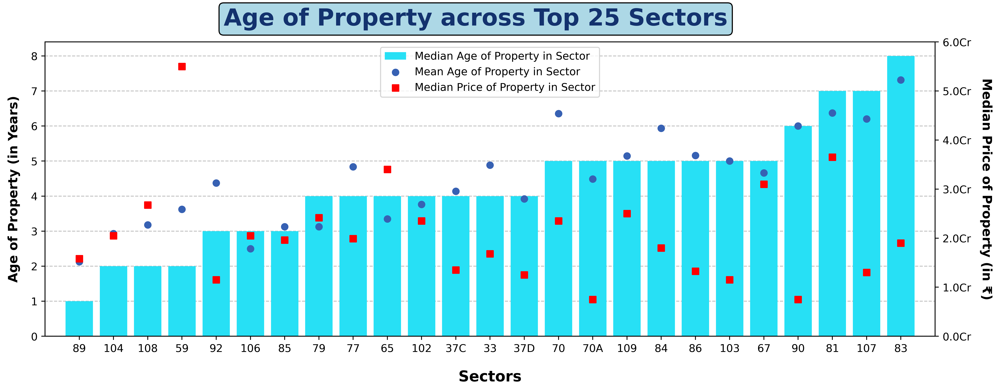

In [368]:
def Age_of_Properties_across_the_Top_25_Sectors():
    ## Prepare data:
    top_25_sec = df['Sector'].value_counts().drop('-').head(25).index
    
    data = df[(df['Sector'].isin(top_25_sec)) & (df['Age_of_property_in_years'] != '-')]
    data = data.astype({'Age_of_property_in_years':'int16'})
    
    data_plot = data.groupby(by = 'Sector')[['Sector', 'Age_of_property_in_years',
                                            'Price_in_rupees']].agg({
                                                            'Age_of_property_in_years':['mean', 'median'],
                                                            'Price_in_rupees':'median'})
    
    data_plot.sort_values(by = ('Age_of_property_in_years', 'median'), inplace = True)
    
    data_med = data_plot['Age_of_property_in_years']['median']
    data_avg = data_plot['Age_of_property_in_years']['mean']
    data_price = data_plot['Price_in_rupees']['median']
    ## ---------------------------------------------------------------------------------------------------
    ## Creating Plot:
    fig = plt.figure(figsize = (15,5), dpi = 500)
    ax = fig.add_subplot(1,1,1)
    ax.grid(axis = 'y', alpha = 0.8, zorder = 1, linestyle ='--')
    
    fig.suptitle("Age of Property across Top 25 Sectors" , 
                  fontweight = 'bold', fontsize = 22, color = '#13326E', ha='center', x=0.5, y=0.97,
                 bbox={'facecolor': 'lightblue',     # Background color
                       'edgecolor': 'black',         # Border color
                       'boxstyle': 'round, pad=0.2', # Rounded box, with padding
                       'linewidth': 1                # Border thickness
                      })
    
    bar = ax.bar(height = data_med.values, x = data_med.index, color = '#27E0F5',
                 label = 'Median Age of Property in Sector', zorder = 2)
    scatter1 = ax.scatter(x = data_avg.index , y = data_avg.values, color = '#3761B3',
                          label = 'Mean Age of Property in Sector', zorder = 3)
    
    ax.set_ylabel('Age of Property (in Years)', fontsize=12, fontweight='bold', labelpad=10)
    ax.set_xlabel('Sectors', fontsize=14, fontweight='bold', labelpad=15)
    ax.set_xlim(-1,25)
    ax.set_xticks(list(range(25)))
    ax.set_xticklabels(pd.Series(data_plot.index).apply(lambda x: x.split()[-1]), rotation = 0)
    
    ## Creating Twin axis:
    ax1 = ax.twinx()
    scatter2 = ax1.scatter(data_price.index, data_price.values, label = 'Median Price of Property in Sector',
                           zorder = 4, marker = ',', color = 'red')
    ax1.set_ylabel('Median Price of Property (in ₹)', fontsize=12, fontweight='bold', 
                   labelpad=20, rotation=-90)
    
    ax1.set_ylim(0, 60000001)
    ax1.set_yticks(list(range(0, 60000001, 10000000)))
    ax1.set_yticklabels([str(round(i/(10000000) , 2)) + 'Cr' for i in list(range(0, 60000001, 10000000))])
    
    ## Merging Labels of 3 plots:
    labels = [plot.get_label() for plot in [bar, scatter1, scatter2]]
    ax.legend([bar, scatter1, scatter2], labels, loc="upper center")
    
    plt.show()

Age_of_Properties_across_the_Top_25_Sectors()

### **`🔍 OBSERATIONS :`**
* **Median Property Age** across sectors **ranges from 1 year (Sector 89)** to **8 years (Sector 83)**.
* **Many sectors (e.g., 104, 108, 59, 92)** show **relatively new properties** with a median age below 3 years.
* Sectors like **83, 107, 81, 90** have **older inventories** with **median age >6 years**.
* **Mean property age** (blue dots) in most sectors is slightly higher than the median, suggesting a **few older properties are pulling the average up**.
* **Median property price (₹, red squares)** does **not follow the age trend directly**—some new sectors have high prices (e.g., Sector 108, 65), while some older ones have moderate prices.


### **`💡 Interpretation`**
* **Young sectors (1–3 years median age):** These are **mostly newly developed or recently launched projects**, signaling active real estate development and modern housing stock.
* **Middle-aged sectors (4–6 years median age):** Represent a balance of **established infrastructure and availability of resale units**.
* **Older sectors (7+ years):** Likely **more mature localities with settled communities** but fewer new launches.
* **Price vs Age disconnect:** High property prices are not only driven by newness of inventory but also by **location attractiveness, amenities, and connectivity**. For example, Sector 108 (younger) and Sector 65 (middle-aged) command higher prices despite differing age profiles.


### **`🎯 Implication for Stakeholders`**
* **Homebuyers:**
  * Buyers seeking **modern amenities and new construction** should target younger sectors like 89, 104, and 108.
  * Buyers preferring **established neighborhoods** may explore older sectors like 83, 81, and 107.
* **Investors:**
  * Newer sectors can offer better **capital appreciation potential**, especially where infrastructure is still improving.
  * Older sectors may provide **stable rental yields** given mature demand.
* **Developers:**
  * Opportunity to **launch new projects in older, high-demand sectors** (e.g., 83, 81) where inventory is aging.
  * **Sustaining premium positioning in young but high-priced sectors** like 65 and 108 **will require continued amenity-driven differentiation**.

---

### **`✅ CONCLUSION :`**
The analysis shows that **Property Age is NOT the sole determinant of price** in Gurugram’s real estate market. 
+ **While younger sectors** generally **indicate new development** and potential for appreciation, **prices are equally influenced by** - **sector location, infrastructure, and premium positioning**.
+ **For stakeholders**, balancing between **new growth corridors** and **established sectors** is key to making informed real estate decisions.
<br><br>

---
# **`F.` Can we cluster Sectors based on "Sector Affordability" and  "Sector level Amenities"?**
- **Sector Affordability** can be studied by comparing **Sector-wise Median Price Density (in ₹/Sq.ft)**.
- **Sector level Amenities** can be studied using **Sector Amenity Score**.
- We can also use Sector-wise Segmentation into 4 categories to study the clusters.
- **Sectors with Median Price Density:**
    + Less than ₹8,500/Sq.ft -> `AFFORDABLE`
    + ₹8,500/Sq.ft to ₹12,500/Sq.ft -> `MID-RANGE`
    + ₹12,500/Sq.ft and ₹17,000/Sq.ft -> `EXPENSIVE`
    + More than ₹17,000/Sq.ft -> `LUXURY`

#### **`ADDITIONAL QUESTIONS TO ANSWER :`**
+ Does Sector Amenity Score increases with Sector-wise Price Density?
+ Are there clusters with Weak Amenities and lower Price/Sq.ft and better Amenities and higher Price/Sq.ft?

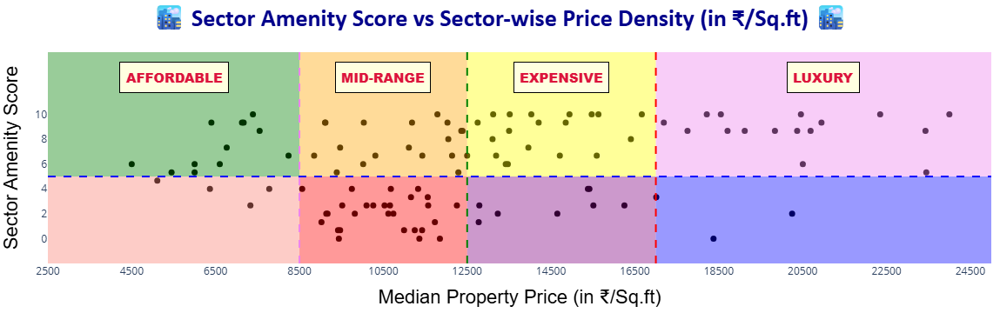

In [465]:
def Can_we_luster_Sectors_based_on_Sector_Affordability_and_Sector_level_Amenities():
    ## Preparing data:
    data = df[df["Sector"] != '-']
    data = data.groupby(by='Sector')[['Avg_price_rupee_per_sqft', 
                                      'Sector_Amenity_Score']].agg({'Avg_price_rupee_per_sqft':'median',
                                                                  'Sector_Amenity_Score':'median'})
    ## Using Segementation Criterions:
    q1 = 8500
    q2 = 12500
    q3 = 17000
    
    ## Creating plot: -----------------------------------------------------------------------------------
    fig = go.Figure()
    
    # Add colored rectangles (layered in order)
    fig.add_shape(type="rect", x0=2500,  x1=q1, y0=5, y1=15, fillcolor="green", opacity=0.4, line=dict(width=0))
    fig.add_shape(type="rect", x0=2500,  x1=q1, y0=-2, y1=5, fillcolor="salmon", opacity=0.4,line=dict(width=0))
    
    fig.add_shape(type="rect", x0=q1, x1=q2, y0=5, y1=15, fillcolor="orange", opacity=0.4, line=dict(width=0))
    fig.add_shape(type="rect", x0=q1, x1=q2, y0=-2, y1=5, fillcolor="red", opacity=0.4, line=dict(width=0))
    
    fig.add_shape(type="rect", x0=q2, x1=q3, y0=5, y1=15, fillcolor="yellow", opacity=0.4, line=dict(width=0))
    fig.add_shape(type="rect", x0=q2, x1=q3, y0=-2, y1=5, fillcolor="purple", opacity=0.4, line=dict(width=0))
    
    fig.add_shape(type="rect", x0=q3, x1=25000, y0=5, y1=15, fillcolor="violet", opacity=0.4, line=dict(width=0))
    fig.add_shape(type="rect", x0=q3, x1=25000, y0=-2, y1=5, fillcolor="blue", opacity=0.4, line=dict(width=0))
    
    ## Scatter Plot:
    fig.add_trace(go.Scatter(x = data['Avg_price_rupee_per_sqft'], y = data['Sector_Amenity_Score'], 
                             mode='markers', marker=dict(color='black', size = 7), text=data.index,
                            customdata = data.values,  # pass extra data
                            hovertemplate=("<b>%{text}</b><br>"
                                           "Median Price(in ₹/Sq.ft): %{customdata[0]:,.0f}<br>"
                                           "Sector Amenity Score: %{customdata[1]:.2f}<br><extra></extra>")))
    
    ## Adding Vertical lines creating compartments of Sector Segments:
    fig.add_vline(x=q1, line=dict(color="violet", dash="dash"))
    fig.add_vline(x=q2, line=dict(color="green", dash="dash"))
    fig.add_vline(x=q3, line=dict(color="red", dash="dash"))
    fig.add_hline(y=5, line=dict(color="blue", dash="dash"))
    
    
    ## Annoting Sector Segments:
    for cate, x_pos in zip(['AFFORDABLE', 'MID-RANGE', 'EXPENSIVE', 'LUXURY'], [5500, 10500, 14750, 21000]):
        fig.add_annotation(
            x=x_pos, y=13, text=cate,         # text content
            showarrow=False,                  # arrow pointing
            font=dict(
                size=15, color="crimson",    # font customization
                family="Arial Black"),
            bgcolor="lightyellow",           # background color
            bordercolor="black",             # border around text
            borderwidth=1, borderpad=6       # padding inside box
        )
    
    ## Update layout:
    fig.update_layout(autosize=True, margin=dict(l=10, r=10, t=60, b=10), height=400,
                      xaxis_range=[2500, 25000],yaxis_range=[-2, 15], plot_bgcolor='white',
                     title=dict(text="<b>🏙️ Sector Amenity Score vs Sector-wise Price Density (in ₹/Sq.ft) 🏙️</b>",
                                 font=dict(size=28, color="darkblue", family='Calibri'), x = 0.5, 
                                 pad=dict(t=90, b=0, l=20, r=20)),
                     xaxis = dict(title = dict(text="Median Property Price (in ₹/Sq.ft)",
                                               font=dict(size=22, color="black", family='Arial'))),
                     yaxis = dict(title = dict(text="Sector Amenity Score",
                                               font=dict(size=22, color="black", family='Arial'))))
    
    fig.update_xaxes(tickvals = np.arange(2500, 25000, 2000), ticktext = np.arange(2500, 25000, 2000))
    fig.update_yaxes(tickvals = np.arange(-2, 12, 2), ticktext = [' '] + list(np.arange(0, 12, 2)))
    
    fig.show()

Can_we_luster_Sectors_based_on_Sector_Affordability_and_Sector_level_Amenities()

### **`🔍 OBSERVATIONS :`**
* The scatterplot maps **Median Property Price Density (₹/Sq.ft)** on the X-axis against **Sector Amenity Score** on the Y-axis.
* We are **using Sector-wise Segmentation** developed based on data and market research i.e., **4 Segments** - **Affordable, Mid-Range, Expensive, and Luxury** based on **Median Price Density (₹/Sq.ft)**.
* A **visible spread exists in Amenity Scores across all price categories**, with some clusters showing high livability at low prices and others showing high prices with weaker amenities.


### **`💡 Interpretation`**
* **Affordable Segments (< ₹8,500/Sq.ft):** Many sectors here exhibit **moderate-to-high amenity scores**, making them **potential “value-for-money” choices**.
* **Mid-Range Segments (₹8,500–₹12,500/Sq.ft):** These sectors show a **wider variance** in amenities — some with strong infrastructure and some lagging, **suggesting uneven development**.
* **Expensive Segments (₹12,500–₹17,000/Sq.ft):** Strong presence of **better-amenity clusters**, indicating that **high price here is more justified by livability factors**.
* **Luxury Segments (> ₹17,000/Sq.ft):** Prices remain high, but **amenity scores vary** — some sectors are **truly premium with strong amenities**, while others are **price-driven zones** with weaker livability factors.


### **`🎯 Implication for Stakeholders`**
* **Homebuyers:**
  * Affordable & Mid-range zones with high amenities provide **best balance of cost and livability**.
  * Luxury segments must be evaluated carefully — not all command high prices due to strong amenities.
* **Investors:**
  * Affordable-high-amenity clusters have **long-term appreciation potential**.
  * Expensive-high-amenity sectors are **stable investments** with lower risk.
* **Urban Planners/Developers:**
  * **Focus** needed in **mid-range and luxury low-amenity zones** to ))bridge infrastructure gaps)).
  * Policies could help uplift weaker-amenity affordable areas to maximize livability equity.

---

### **`✅ CONCLUSION :`**
The analysis highlights that **price alone does not guarantee livability**. Gurugram shows a mix of sectors where **affordability aligns with good amenities** and others where **premium prices are not fully backed by livability factors**. For buyers and investors, this underscores the importance of evaluating both **price density and amenity score together**, rather **than relying solely on cost**.

---

### **❓ Additional Questions to Answer**
- **1. Does Sector Amenity Score increase with Sector-wise Price Density?**
    * ***Not consistently***. While higher price density tends to coincide with higher amenities in some clusters (especially Expensive category), there are several exceptions in Luxury zones where price is high but amenity scores are moderate to weak.
- **2. Are there clusters with Weak Amenities and lower Price/Sq.ft and better Amenities and higher Price/Sq.ft?**
    * ✅ Yes.
      * **Weak Amenities + Lower Price:** Found in Affordable–Low and Mid-Range–Low segments. These are budget-driven zones.
      * **Better Amenities + Higher Price:** Found mainly in Expensive and Luxury categories where premium livability is driving higher valuations.

<br><br>

---
# **`G.` Is there a trend between 'Sector Number' and 'Property Pricing' *(e.g., higher sector = newer = more expensive)* ?**

#### **`🗺️ NUMBERING OF SECTORS OF GURUGRAM :`**
- The **numbering of Sectors** in Gurugram (formerly Gurgaon) is **NOT STRICTLY sequential based on** the **order of their creation**.
- While **there's a general progression** from **older to newer sectors**, the **numbering doesn't perfectly reflect the exact timeline of development**.
- **General Trend:**
    + Older sectors like those in Old Gurgaon (e.g., sectors 1-23) were developed earlier, while
    + Newer sectors, such as those along the Dwarka Expressway and in New Gurgaon (e.g., sectors 76-95, 102-113), were developed later.
- **No Strict Sequence:** However, **there's not a strict one-to-one correlation between sector number and the year of development**. Some sectors might have been **developed out of sequence**, or with **gaps in numbering**.

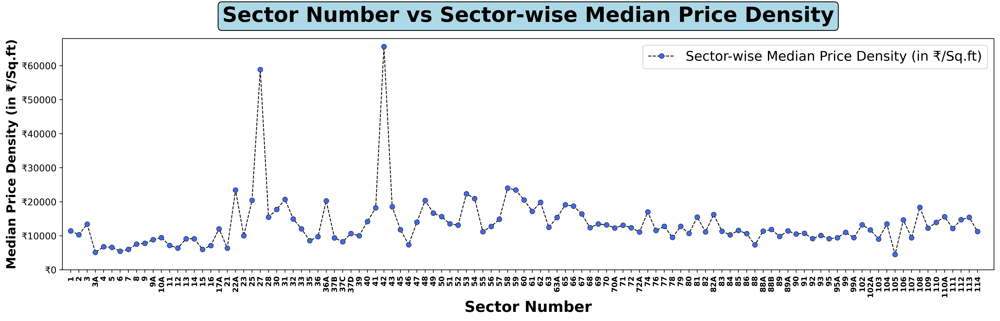

In [554]:
def trend_bw_sector_numbers_and_development_and__pricing():
    ## Preparing data for analysis:
    data = df[df['Sector'] != '-']
    sec_pricing = data.groupby(by='Sector')[['Avg_price_rupee_per_sqft']].agg({
        'Avg_price_rupee_per_sqft':'median'}).reset_index()
    
    def sort_sec(sector):
        x = sector.split()[-1]
        if x[-1].isdigit():
            return int(x)
        elif x[-1] == 'A':
            return int(x[0:-1]) + 0.1
        elif x[-1] == 'B':
            return int(x[0:-1]) + 0.2
        elif x[-1] == 'C':
            return int(x[0:-1]) + 0.3
        elif x[-1] == 'D':
            return int(x[0:-1]) + 0.4
    
    sec_pricing['Sector Order'] = sec_pricing['Sector'].apply(sort_sec)
    sec_pricing = sec_pricing.sort_values(by = 'Sector Order').reset_index(drop=True)
    
    ## ------------------------------------------------------------------------------------------------
    ## Creating Plot: 
    fig = plt.figure(figsize = (20,5), dpi = 500)
    ax = fig.add_subplot(1,1,1)
    bbox={'facecolor': 'lightblue','edgecolor': 'black','boxstyle': 'round, pad=0.2','linewidth': 1}
    
    ax.plot(sec_pricing['Sector'].apply(lambda x: x.split()[-1]), sec_pricing['Avg_price_rupee_per_sqft'], 
            linewidth=1, color='black', linestyle='--', label = 'Sector-wise Median Price Density (in ₹/Sq.ft)', 
            marker = 'o', markersize=6,  markerfacecolor='royalblue',markeredgecolor='black', 
            markeredgewidth = 0.4)
    
    
    ax.set_title('Sector Number vs Sector-wise Median Price Density', 
                 fontsize=25, fontweight='bold', bbox = bbox, pad = 20)
    ax.set_ylabel('Median Price Density (in ₹/Sq.ft)', fontsize=15, fontweight='bold')
    ax.set_xlabel('Sector Number', fontsize=18, fontweight='bold')
    
    ax.set_xlim(-1, sec_pricing.shape[0] + 1)
    ax.set_xticks(list(range(0, sec_pricing.shape[0])))
    ax.set_xticklabels(sec_pricing['Sector'].apply(lambda x: x.split()[-1]), rotation = 90, 
                       fontsize = 9, fontweight = 'bold')
    
    ax.set_ylim(0,68000)
    ax.set_yticks(list(range(0, 65001, 10000)))
    ax.set_yticklabels([f"₹{i}" for i in range(0, 65001, 10000)], fontsize = 11)
    
    ax.legend(fontsize=16, loc = 'upper right')
    
    plt.show()

trend_bw_sector_numbers_and_development_and__pricing()

#### **`PEARSON CORRELATION TEST :`**
- Measuring **correlation coefficient** between "Sector Number" and "Sector-wise Price Density".

In [563]:
## t-test for Pearson correlation coefficient:
from scipy.stats import pearsonr

r, p_value = pearsonr(sec_pricing['Sector Order'], sec_pricing['Avg_price_rupee_per_sqft'])
print(f"Pearson Correlation Coefficient r: {r:.5f}, p-value: {p_value:.6f}")

Pearson Correlation Coefficient r: -0.00389, p-value: 0.967677


### **`🔍 OBSERVATIONS :`** 
* The plot shows sector-wise **Median Price Density (₹/Sq.ft)** across all numbered sectors of Gurugram.
* Most sectors fall within a **₹8,000–₹20,000 per Sq.ft** band.
* **NOTE:** Sector 27 and 42 are outliers in data (₹60,000+/Sq.ft) cause all the property listed in Sector 42 are DLF Properties which are usually Premium high-end luxurious properties and Sector 27 has only 1 property listing. 
* The **trendline is fairly volatile** but **DOES NOT show any consistent increasing or decreasing relationship with sector numbers**.
* **`Pearson Correlation Test:`** **r = -0.00389, p-value = 0.968**, confirming there is **no significant correlation** between sector numbers and price density.


### **`💡 Interpretation`**
* **No Sequential Pattern:** Sector numbers are **administrative/geographical labels** and **do not inherently reflect property pricing trends**. Hence, prices do not follow the sequence of sector numbers.
* **Localized Outliers:** Certain Sectors like 22A, 31 and 36A represent premium micro-markets, likely driven by luxury developments, commercial hubs, or elite neighborhoods.
* **General Band of Stability:** **Most sectors cluster within the median band**, suggesting that **large price differences if any are localized exceptions rather than city-wide systematic trends**.
* **Data Variability:** The **small spikes** (other than Sector 27 & 42) **indicate** that Gurugram has a **heterogeneous property market**, with **pockets of luxury alongside moderately priced sectors**.


### **`🎯 Implication for Stakeholders`**
* **Homebuyers:**
  * **Should not assume higher sector numbers mean newer properties and higher prices** — decisions must be made based on **local amenities, development stage, and demand-supply dynamics**, not sector numbering.
* **Investors:**
  * Mid-band sectors (~₹8,000–₹17,000/Sq.ft) offer **broader investment opportunities with balanced risk-return**.
* **Urban Planners/Policymakers:**
  * Need to **examine drivers of price spikes in luxury sectors** (> ₹17,000/Sq.ft) (e.g., infrastructure projects, commercial presence) and **assess if such patterns can be replicated in other regions**.

---

### **`✅ CONCLUSION :`**
The analysis confirms that **Sector Numbering has no *Statistical Correlation* with Property Price Density** in Gurugram. 
+ Instead, **price variations** are **driven by localized factors** such as *premium projects*, *infrastructure*, and *proximity to commercial hubs*. **Stakeholders** must therefore **evaluate property investment** at a **micro-market (sector-specific) level**, rather than relying on **broad sector numbering** as a proxy for affordability or costliness.
<br><br><br>

---
# **`H.` Distribution of 5 Major Flat types across the top 25 Sectors (top sectors based on number of property listings)?**
- Lets study distribution of 5 Major Flat Types across Top 25 Sectors with highest total property listings.
- We already now the composition of Flat market of Gurugram.

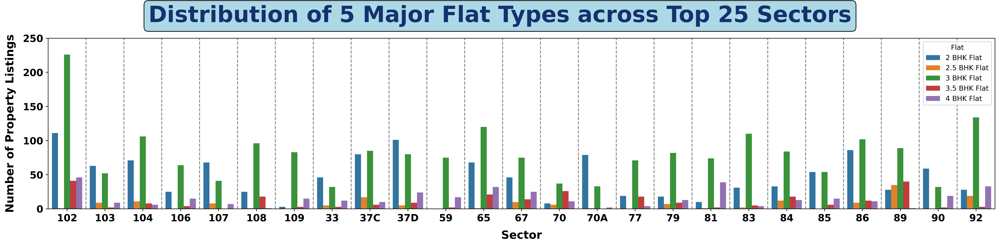

In [607]:
## Preparing data:
five_maj_ft = ["2 BHK Flat", "2.5 BHK Flat", "3 BHK Flat",  "3.5 BHK Flat", "4 BHK Flat"]
top_25_sec = df['Sector'].value_counts().drop('-').head(25).index

data = df[(df['Sector'].isin(top_25_sec)) & (df['Flat'].isin(five_maj_ft))]
data = data.groupby(by = ['Sector', 'Flat'])[['Sector', 'Flat']].apply(lambda x: 
                                                   x.shape[0]).unstack().fillna(0).astype('int16')

data_for_bar_plot = data.stack().reset_index().rename(columns = {0:'Number_of_listings'
                                                                }).sort_values(by = 'Sector')

## Creating Plot: --------------------------------------------------------------------------------------
fig = plt.figure(figsize = (20,5), dpi = 500)
ax = fig.add_subplot(1,1,1)

fig.suptitle("Distribution of 5 Major Flat Types across Top 25 Sectors" , 
              fontweight = 'bold', fontsize = 32, color = '#13326E', ha='center', x=0.5, y=0.97,
             bbox={'facecolor': 'lightblue',     # Background color
                   'edgecolor': 'black',         # Border color
                   'boxstyle': 'round, pad=0.2', # Rounded box, with padding
                   'linewidth': 1                # Border thickness
                  })

ax = sns.barplot(data = data_for_bar_plot, x = 'Sector', y = 'Number_of_listings', hue = 'Flat')
    
# Matplotlib customizations
ax.set_xlabel("Sector", fontsize=16, color='black', labelpad=10, fontweight='bold')
ax.set_ylabel("Number of Property Listings", fontsize=16, color='black', labelpad=10, fontweight='bold')

# Customize ticks
ax.set_yticks(np.arange(0, 251, 50))
ax.set_yticklabels(np.arange(0, 251, 50), fontsize=14, color='black', fontweight='bold')

ax.set_xticks(list(range(25)))
x_ticks_lab = sorted(data_for_bar_plot["Sector"].unique())
ax.set_xticklabels(pd.Series(x_ticks_lab).apply(lambda x: x.split()[-1]).values,
                   fontsize=14, fontweight='bold', color='black', rotation = 0)

for i in np.linspace(0.5,23.5,24):
    plt.axvline(i, color='grey', linestyle='--', linewidth=1.2)

plt.tight_layout()
#plt.legend(title='Flats', fontsize=14, loc='upper center')
plt.show()

### **`🔍 OBSERVATIONS :`**
* The chart displays the distribution of **five major flat types (2, 2.5, 3, 3.5, and 4 BHK)** across the **top 25 sectors** of Gurugram.
* **3 BHK flats dominate** the listings **in most sectors**, with some sectors (e.g., 102, 92, 65, 83) showing especially **high concentrations**.
* **2 BHK flats** are **also quite prominent**, particularly in sectors like **102, 37D, 70A, and 86**.
* **Higher BHK configurations (3.5 and 4 BHK)** are **less frequent** but show presence across certain sectors like **89, 90, 81 etc**.
* **Some sectors** (e.g., **103, 109, 70**) show **relatively lower flat distribution overall** compared to others.


### **`💡 Interpretation`**
* **3 BHK as the market backbone:** The **dominance of 3 BHK flats** suggests that this configuration is the **most sought-after size segment** for families in Gurugram.
* **2 BHK demand pockets:** The **strong presence of 2 BHK flats in several sectors** indicates demand from **young professionals, small families, or investors** targeting rental yields.
* **Premium concentration of large flats:** The **availability of 3.5 and 4 BHK flats in select sectors** points to the **premium housing demand**, likely **driven by high-income groups**.
* **Sector variation:** The spread of flat types is not uniform — suggesting sector-level differences in **buyer demographics, affordability, and developer focus**.


### **`🎯 Implication for Stakeholders`**
* **For Developers:**
  * Focus on **3 BHK units as the core product** in most sectors.
  * **In emerging affordable hubs**, **increase supply of 2 BHK units** to cater to the growing mid-income population.
  * **In premium corridors** (e.g., 92, 90, 86), **expand offerings of 3.5 and 4 BHK units** for luxury buyers.
* **For Buyers:**
  * **Families looking for variety** should consider **3 BHK-dominant sectors** for better choice and competitive pricing.
  * **Budget-conscious buyers and investors** should explore **2 BHK-heavy sectors** for affordability and rental prospects.
  * **High-net-worth individuals** may target **premium sectors with larger flats** for exclusivity and long-term appreciation.
* **For Policymakers/Urban Planners:**
  * Balance infrastructure planning with the **dominance of mid-sized units (3 BHK)**.
  * Ensure **affordable housing initiatives** are aligned with sectors having rising 2 BHK demand.
  * Plan **amenities and services** in premium sectors to match the lifestyle of large flat owners.

---

### **`✅ CONCLUSION :`**
The analysis clearly shows that **3 BHK flats form the backbone of Gurugram’s residential market**, with **2 BHKs capturing the affordable and rental-driven segments** and **larger flats (3.5–4 BHK) shaping the luxury landscape**. This diversity highlights Gurugram’s role as a multi-segment real estate hub, catering simultaneously to middle-class families, investors, and high-net-worth individuals.

<br><br>

---
# **`I.` Cluster Sectors of Gurugram into broad Localities & Plot on Map using Geo Spatial data.**
- **Look for dominating Flat types in each Locality**.
- Mark which Segment does the Sector belongs  - i.e., **Affordable, Mid-Range, Expensive, and Luxury**

#### **`NOTE :`** We already have Locaility markings and Geo Spatial Centroids of each the Sectors.

In [27]:
import osmnx as ox
import folium
import random
from typing import List, Tuple, Optional
from shapely.geometry import MultiPoint, Polygon, mapping, Point
import alphashape

## Using already collected Geo Spatial data: 
sec_location = pd.read_csv('sector_geo_centroid_data.csv', index_col = 'Unnamed: 0')
sec_location['latitude'] = sec_location['Location_(lat_long)'].apply(lambda x: x[1:-1].split(', ')[0])
sec_location['longitude'] = sec_location['Location_(lat_long)'].apply(lambda x: x[1:-1].split(', ')[1])

sec_location.head()

,Sector,Location_(lat_long),Locality,latitude,longitude
0,Sector 1,"(28.5187813, 77.0418623)",Old Gurgaon,28.5187813,77.0418623
1,Sector 102,"(28.4754872, 76.9711747)",Dwarka Expressway Belt,28.4754872,76.9711747
2,Sector 102A,"(28.4830826, 76.9779064)",Dwarka Expressway Belt,28.4830826,76.9779064
3,Sector 103,"(28.493087, 76.9866453)",Dwarka Expressway Belt,28.493087,76.9866453
4,Sector 104,"(28.4795324, 76.9937197)",Dwarka Expressway Belt,28.4795324,76.9937197


#### **MAP WORK:**

In [48]:
def Gurgaon_sector_map_localities():
    ## Using already collected Geo Spatial data: 
    sec_location = pd.read_csv('sector_geo_centroid_data.csv', index_col = 'Unnamed: 0')
    sec_location['latitude'] = sec_location['Location_(lat_long)'].apply(lambda x: x[1:-1].split(', ')[0])
    sec_location['longitude'] = sec_location['Location_(lat_long)'].apply(lambda x: x[1:-1].split(', ')[1])

    ## Create and Plot Convex Hull of Localities:
    def enclosing_polygons_map(m, geo_data, localities_w_colors):
        """
        Build convex-hull polygon around input (lat, lon) points
        and render them on a Folium map.
        Returns (folium.Map).
        """
        localities_polygons = []
        
        for locality in localities_w_colors.keys():
            sec_geo_coords = geo_data[geo_data['Locality'] == locality][[
                'latitude','longitude']].astype({'latitude':'float', 'longitude':'float'}).values
    
            if len(sec_geo_coords) < 3:
                raise ValueError("At least 3 points are required to form a polygon")
    
            ## Create Convex hull (guaranteed to enclose all points):
            lon_lat_points = [(lon, lat) for lat, lon in sec_geo_coords]
            hull = MultiPoint(lon_lat_points).convex_hull                    # shapely Polygon or LineString
            if hull.geom_type != "Polygon":
                ## Handle collinear or 2-point edge cases
                hull = hull.buffer(1e-9)

            localities_polygons.append(tuple([locality, hull]))

        ## List of Geo-Polygons of Localities of Gurugram:
        localities = localities_polygons
        
        ## Removing the area of "New Gurugram" from "Old Gurgaon":
        intersection = localities[5][1].intersection(localities[3][1])
        revised_old_gurgaon = localities[5][1].difference(intersection)

        ## Removing overlapping regions of "MG Road" and "Golf Course areas":
        intersection = localities[1][1].intersection(localities[4][1])
        revised_mg_road = localities[1][1].difference(intersection)
        revised_golf_course = localities[4][1].difference(intersection)
        
        ## Upadting the List:
        localities[5] = ('Old Gurgaon', revised_old_gurgaon)
        #localities[1] = ('MG Road & Central Gurugram', revised_mg_road)
        #localities[4] = ('Golf Course Road & Extension', revised_golf_course)
                
        ## Style and Add Polygons (GeoJSON expects [lon, lat] order)
        def add_poly(geom, name, color, fill_color, opacity=0.9, fill_opacity=0.20):
            gj = folium.GeoJson(
                data=mapping(geom),
                name=name,
                style_function=lambda feat: {"color": color,"weight": 3,"opacity": opacity,
                                             "fillColor": fill_color,"fillOpacity": fill_opacity})#.add_to(m)
            folium.Popup(name).add_to(gj)
            gj.add_to(m)               

        for locality, shape in localities:
            add_poly(shape, locality, color=localities_w_colors[locality], 
                     fill_color=localities_w_colors[locality])

            
    ## ------------------------------------------------------------------------------------------------------
    ## Plotting all the Sectors on Map - using scrapped Geo Centroids:
    sectors_list = sec_location[['Sector', 'Location_(lat_long)', 'Locality']].values
    sec_local_color = {'Dwarka Expressway Belt':'cadetblue',
                       'MG Road & Central Gurugram':'blue','Southern Peripheral Road (SPR) Belt':'darkblue', 
                       'New Gurugram':'gray', 'Golf Course Road & Extension':'red', 'Old Gurgaon':'green'}
    
    ## Step 1: Create folium map centered on "Sector 10A":
    map_center = sec_location[sec_location['Sector'] == 'Sector 10A']      ## Map center...
    
    m = folium.Map(location=[float(map_center['latitude'].iloc[0]) + 0.009, 
                             float(map_center['longitude'].iloc[0])], 
                   zoom_start=11.5, no_touch=False , width='100%', height=590, 
                   dragging=True, zoom_control=False, scrollWheelZoom=False, 
                   doubleClickZoom=False, box_zoom=False, touchZoom=False, tiles='OpenStreetMap')
    
    
    ## Step 2: Marking Sectors using Geo Coordinates on Map:
    for sector, point, locality in sectors_list: 
        location_name = sector + ", Gurugram, Haryana, India"
        point = point[1:-1].split(', ')
    
        # Step 3: Add a marker
        folium.Marker(
            location=[point[0], point[1]],  ## (lat, lon) as (y, x)
            popup=location_name + '\n(' + locality + ')',
            tooltip=location_name + '\n(' + locality + ')',
            icon=folium.Icon(color = sec_local_color[locality], icon="building", prefix='fa'),
            #icon=folium.DivIcon(html='<div style="font-size:14pt; color: darkred;">📍</div>')        
        ).add_to(m)
    
    title_html = '''
         <h2 align="center" style="font-size:20px"><b>Gurugram Map View</b></h2>
         '''
    m.get_root().html.add_child(folium.Element(title_html))
    
    ## Step 3: Adding borders around Localities: 
    enclosing_polygons_map(m, sec_location, localities_w_colors = sec_local_color)
    
    
    ## Step 4: Adding Gurugram boundary:
    gdf = ox.geocode_to_gdf("Gurugram, Haryana, India")
    
    city_boundary = folium.GeoJson(gdf.geometry.__geo_interface__, name="Gurgaon Boundary",
                                   style_function=lambda x: {"color": "black", "weight": 3, "fill": False},)
    folium.Popup("Gurgaon Boundary").add_to(city_boundary)
    city_boundary.add_to(m)
    
    ## Step 4: Save or show the map
    return m

Gurgaon_sector_map_localities()

### **`NOTE :`**
- Here Sectors are clustered based on broad Localities.
- Now we can move on to study these Localities and unearth insights.

## **`I.a.` Distribution of 5 Major Flat Types across 6 Localities of Gurugram**

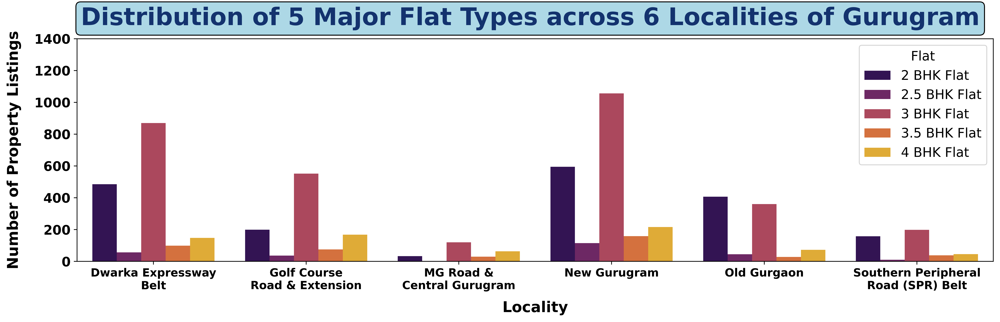

In [80]:
## Using already collected Geo Spatial data: 
sec_location = pd.read_csv('sector_geo_centroid_data.csv', index_col = 'Unnamed: 0')

def Distribution_of_5_Major_Flat_Types_across_6_Localities_of_Gurugram(sec_location):
    ## Preparing data for analysis:
    data_local = pd.merge(sec_location, df, how='inner', on='Sector')
    five_maj_ft = ["2 BHK Flat", "2.5 BHK Flat", "3 BHK Flat",  "3.5 BHK Flat", "4 BHK Flat"]
    
    ## Only keeping records with Flat from 5 Major Flat types:
    data_local = data_local[data_local['Flat'].isin(five_maj_ft)]
    
    ## grouping data based on Locality and Flat, and counting total records in each group:
    grouped_data = data_local.groupby(by = ['Locality', 'Flat'])[['Locality','Flat']].apply(lambda x: x.shape[0])
    grouped_data = grouped_data.reset_index(drop=False).rename(columns = {0:'Num_listings'})
    
    ## Creating plot : ---------------------------------------------------------------------------------------
    fig = plt.figure(figsize = (15,5), dpi = 500)
    ax = fig.add_subplot(1,1,1)
    
    fig.suptitle("Distribution of 5 Major Flat Types across 6 Localities of Gurugram" ,
                 fontweight = 'bold', fontsize = 26, color = '#13326E', ha='center', x=0.53, y=0.95,
                 bbox={'facecolor': 'lightblue', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 
                       'linewidth': 1})
    
    ax = sns.barplot(data = grouped_data, x = 'Locality', y = 'Num_listings', hue = 'Flat', palette='inferno')
        
    # Matplotlib customizations
    ax.set_xlabel("Locality", fontsize=16, color='black', labelpad=10, fontweight='bold')
    ax.set_ylabel("Number of Property Listings", fontsize=16, color='black', labelpad=14, fontweight='bold')
    
    # Customize ticks
    ax.set_yticks(np.arange(0, 1401, 200))
    ax.set_yticklabels(np.arange(0, 1401, 200), fontsize=14, color='black', fontweight='bold')
    
    ax.set_xticks(list(range(6)))
    local_names = ['Dwarka Expressway\nBelt', 'Golf Course\nRoad & Extension',
                   'MG Road &\nCentral Gurugram', 'New Gurugram', 'Old Gurgaon',
                   'Southern Peripheral\nRoad (SPR) Belt']
    ax.set_xticklabels(local_names, fontsize=12, fontweight='bold', color='black')
    ax.legend(fontsize=14, title='Flat', title_fontsize=14, facecolor="#ffffff",
             frameon=True, fancybox=True)
    
    plt.tight_layout()
    plt.show()

Distribution_of_5_Major_Flat_Types_across_6_Localities_of_Gurugram(sec_location)

### **`🔍 OBSERVATIONS :`**
* **Across all six major localities** of Gurugram, **3 BHK flats dominate** the property listings, with the **highest concentration** in **New Gurugram and Dwarka Expressway Belt**.
* **2 BHK flats** also have **significant representation**, especially in **New Gurugram, Dwarka Expressway, and Old Gurugram**, indicating *demand for smaller family units*.
* **4 BHK flats** show noticeable **presence in premium corridors** like **Golf Course Road & Extension** and **New Gurugram**.
* **3.5 BHK and 2.5 BHK flats** are **comparatively niche**, with smaller but consistent representation across most localities.
* Localities like **MG Road & Central Gurugram** have **relatively lower supply of all flat types**, compared to emerging hubs.


### **`💡 Interpretation`**
* **3 BHK dominance:** Reflects the preference of **mid-to-upper middle-class families** who view this size as an ideal balance between space and affordability.
* **2 BHK demand pockets:** Highlight the **affordable and rental-driven markets**, attracting **working professionals and nuclear families**.
* **Premium corridors (Golf Course, New Gurugram):** Presence of **4 BHKs and 3.5 BHKs** reflects **luxury housing trends driven by high-income groups**.
* **Supply concentration shift:** **New Gurugram and Dwarka Expressway** have become **development hotspots**, showing **large inventory volumes** compared to established central and old areas.


### **`🎯 Implication for Stakeholders`**
* **Developers:**
  * Should continue focusing on **3 BHK supply** as the **core product line**.
  * In **New Gurugram and Dwarka Expressway**, maintain a mix of **2 & 3 BHKs** to serve both end-users and investors.
  * For **Golf Course Road & premium zones**, upscale supply with **4 BHKs & luxury offerings** to **cater to elite demand**.
* **Buyers:**
  * **Families:** Best choice of 3 BHKs in almost every locality, particularly in **New Gurugram & Dwarka Expressway**.
  * **Young professionals & investors:** Should target **2 BHK-heavy localities** for affordability and rental yield.
  * **Luxury buyers:** Premium living options are best in **Golf Course Road & New Gurugram**.
* **Policymakers/Urban Planners:**
  * Need to plan infrastructure in **New Gurugram & Dwarka Expressway Belt** in sync with growing housing density.
  * Affordable housing policies should be strengthened in **Old Gurugram & Dwarka Expressway**, where smaller units are prevalent.

---

### **`✅ CONCLUSION :`**
The analysis highlights that **3 BHK flats form the backbone of Gurugram’s residential market**, cutting across all localities. **New Gurugram and Dwarka Expressway Belt** are the **fastest-growing hubs**, **offering both affordability (2 BHKs) and family-centric homes (3 BHKs)**. On the other hand, **Golf Course Road & Extension** continue to **represent Gurugram’s luxury segment** with a higher share of **4 BHK and premium configurations**. This **distribution underscores Gurugram’s dual role** as both an **affordable housing hub** for mid-income families and a **luxury destination** for elite buyers.
<br><br>

## **`I.b.` Distribution of Property Cost across 6 Major Localities**

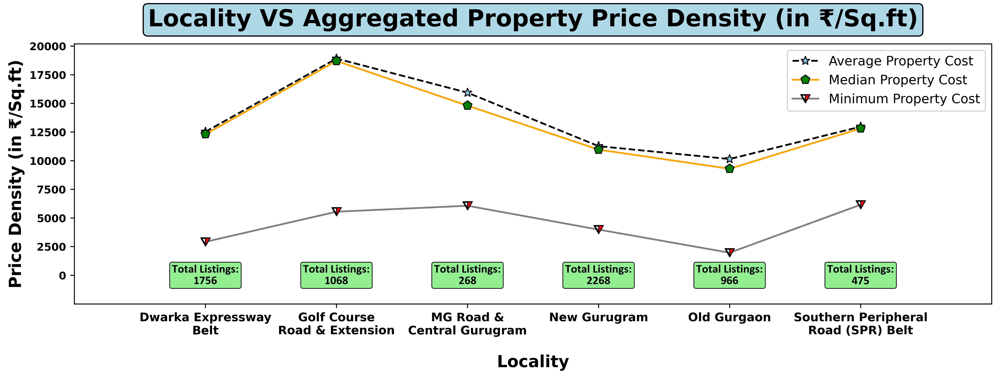

In [541]:
## Using already collected Geo Spatial data: 
sec_location = pd.read_csv('sector_geo_centroid_data.csv', index_col = 'Unnamed: 0')

def Distribution_of_Property_Cost_across_6_Major_Localities(sec_location):
    ## Preparing data for analysis:
    data_local = pd.merge(sec_location, df, how='inner', on='Sector')
    data_local = data_local[data_local['Sector'] != '-']
    
    ## Grouping data based on "Locality" and finding aggregated "Property Price Density (in ₹/Sq.ft)" 
    ## for each of the group:
    def func_pri(data):
        pro_pri = data['Avg_price_rupee_per_sqft']
        return pd.Series([pro_pri.size, pro_pri.min(), pro_pri.max(), pro_pri.mean(), pro_pri.median()],
             index = pd.MultiIndex.from_tuples([('Price', 'tot_prop_listed'), ('Price', 'min'), 
                                                ('Price', 'max'), ('Price', 'mean'), ('Price', 'median')]))
    
    data_local = data_local.groupby(by = 'Locality').apply(func_pri).astype({('Price','tot_prop_listed'):'int32'
                                                                            })
    data = data_local.sort_index().reset_index()
    
    ## ------------------------------------------------------------------------------------------------
    ## Creating Plot: 
    fig = plt.figure(figsize = (14,4), dpi = 500)
    ax = fig.add_subplot(1,1,1)
    bbox={'facecolor': 'lightblue', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 'linewidth': 1}
    
    ax.plot(data['Locality'], data[('Price', 'mean')], linewidth=1.5, color='black', linestyle='--',
            label = 'Average Property Cost', marker = '*', markersize  = 8,  markerfacecolor='skyblue',
            markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.plot(data['Locality'], data[('Price', 'median')], color='orange', linestyle='solid',
            linewidth=1.5, label = 'Median Property Cost', marker = 'p', markersize  = 8, 
            markerfacecolor='green',markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.plot(data['Locality'], data[('Price', 'min')], linewidth=1.5, color='grey', linestyle='solid',
            label = 'Minimum Property Cost', marker = '$⧩$', markersize  = 8,  markerfacecolor='red',
            markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.set_title('Locality VS Aggregated Property Price Density (in ₹/Sq.ft)', 
                 fontsize=20, fontweight='bold', bbox = bbox, pad = 15)
    ax.set_ylabel('Price Density (in ₹/Sq.ft)', fontsize=14, fontweight='bold')
    ax.set_xlabel('Locality', fontsize=14, fontweight='bold', labelpad=15)
    
    ax.set_xlim(-1, 6)
    ax.set_xticks(list(range(0, 6)))
    tick_names = ['Dwarka Expressway\nBelt', 'Golf Course\nRoad & Extension',
                  'MG Road &\nCentral Gurugram', 'New Gurugram', 'Old Gurgaon',
                  'Southern Peripheral\nRoad (SPR) Belt']
    ax.set_xticklabels(tick_names, rotation = 0, fontsize = 10, fontweight = 'bold')
    
    ax.set_ylim(-2500,20200)
    ax.set_yticks(list(range(0, 20001, 2500)))
    ax.set_yticklabels([i for i in range(0, 20001, 2500)], fontsize = 9, fontweight = 'bold')
    
    ## Annotate Property Count:
    for prop_count, locality in zip(data[('Price', 'tot_prop_listed')], data['Locality']):
        ax.text(locality, 0, f"Total Listings:\n{prop_count}", ha='center', va='center', fontsize=10, 
                fontweight='bold', fontfamily='Calibri', color='black', 
                bbox={'facecolor': 'lightgreen', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 
                      'linewidth': 0.6} )
    
    ax.legend(fontsize=11, loc = 'upper right')
    
    plt.show()

Distribution_of_Property_Cost_across_6_Major_Localities(sec_location)

### **`🔍 OBSERVATIONS :`**
* **Golf Course Road & Extension** records the **highest property price density** (₹/sq.ft) **across all three measures** – Average, Median, and Minimum.
* **MG Road & Central Gurugram** also **shows relatively high property prices**, though slightly below Golf Course Road.
* **New Gurugram and Dwarka Expressway Belt** have **moderate price densities**, but also the **highest listing volumes** (2268 and 1756 respectively).
* **Old Gurugram** shows the **lowest price density** values, both median and average, **with modest listing volume (966)**.
* **Southern Peripheral Road (SPR) Belt** has **mid-to-high prices**, with median/average around Dwarka Expressway levels but fewer listings (475).
* The **gap between minimum and median prices** is **widest in premium zones** (Golf Course Road, MG Road), **indicating significant price spread and variation** within listings.


### **`💡 Interpretation`**
* **Golf Course Road & MG Road** represent the **premium luxury markets**, supported by **both high median and minimum costs**, reflecting **upscale housing demand**.
* **New Gurugram and Dwarka Expressway Belt** are **emerging affordable-to-mid markets**, with **large inventory** and **relatively moderate prices**, appealing to mass buyers and investors.
* **Old Gurugram** is a **budget-friendly market**, with the lowest property densities, **catering to price-sensitive buyers**.
* **SPR Belt** is positioned as a **developing premium corridor**, with **higher-than-average price density but limited supply**, reflecting early-stage development and **speculative demand**.
* The **large gap between minimum and median prices** in **luxury localities** suggests a **diverse range of property options** — from **budget apartments to high-end luxury housing**.


### **`🎯 Implication for Stakeholders`**
* **Developers:**
  * Should target **Golf Course Road & MG Road** for luxury projects.
  * Focus on **mass-market housing** in **Dwarka Expressway & New Gurugram**, given their high listing volumes.
  * Position **SPR Belt** projects as **premium yet affordable alternatives to Golf Course Road**.
* **Buyers:**
  * **Luxury buyers** should look at **Golf Course Road & MG Road** for prime properties.
  * **Mid-income families & investors** may find better deals in **New Gurugram & Dwarka Expressway**, where supply is abundant.
  * **Budget-sensitive buyers** may prefer **Old Gurugram**, though **with limited long-term appreciation** compared to newer hubs.
* **Policy Makers/Urban Planners:**
  * Need to strengthen **infrastructure and connectivity** in **New Gurugram & Dwarka Expressway**, as these are becoming high-density residential belts.
  * For **SPR Belt**, planned development should focus on creating a balanced supply to prevent overheating of prices.

---

### **`✅ CONCLUSION :`**
The analysis shows a **clear segmentation in Gurugram’s housing market**:
* **Golf Course Road & MG Road** remain the **luxury strongholds**, with **consistently high price densities**.
* **Dwarka Expressway and New Gurugram** are the **fastest-growing, high-supply markets**, driving **affordable-to-mid segment growth**.
* **Old Gurugram** caters to **budget housing**, while **SPR Belt** is **emerging as a premium corridor**.

This **segmentation highlights** Gurugram’s ***Dual Housing Landscape*** — *luxury zones for elite buyers and expanding affordable hubs for the wider population*.

<br><br>

----

### <CENTER>**`SUMMARY: Sector-Wise Property Price Landscape in Gurugram`**<CENTER>

**1. Dwarka Expressway Corridor :**
* Among the **fastest-appreciating zones** in Gurugram, average property prices nearly **doubled** from ₹9,434/sq.ft in 2020 to ₹18,668/sq.ft in 2024.
* In Q1 2024, prices stood at around **₹10,700/sq.ft**, marking a **27% year-on-year growth**.

**2. Golf Course Extension Road (GCER) & MG Road :**
* **MG Road** recorded a massive **50% YoY surge**, reaching ~₹23,400/sq.ft in Q1 2024.
* **GCER** saw prices climb to ~₹16,250/sq.ft in Q1 2024, up ~27% from the previous year.
* Latest estimates (2025) show premium sectors like Sector 42 fetching **₹18,000–25,000/sq.ft**, and Sectors 54–56 averaging **₹14,000–19,000/sq.ft**.

**3. New Gurugram (Sectors 81–95 and Dwarka-linked sectors) :**
* Emerging as **value-for-money growth hotspots**, prices range between **₹5,000–10,000/sq.ft**.
  * Sectors 90–92: ~₹5,000–6,500/sq.ft
  * Sector 82: ~₹5,200–6,800/sq.ft
  * Sectors 84–86: ~₹5,800–7,200/sq.ft

**4. Mid-Range Sectors (Sectors 49–57)**
* Property rates typically lie between **₹5,000–8,000/sq.ft**. For instance, Sector 54–57 show ranges from ~₹7,900 to 8,100/sq.ft in recent reports.

**5. Long-Term Growth Outlook**
* **Southern Peripheral Road (SPR)** corridor has seen a staggering **120% increase** in property prices over five years — from ₹7,690/sq.ft in 2020 to ~₹18,000/sq.ft by mid-2024.

---

#### **Summary Table :**

| Corridor / Sector Cluster    | Price Range (₹/Sq.ft) | Growth Trend              |
| ---------------------------- | --------------------- | ------------------------- |
| Dwarka Expressway            | \~10,700 (Q1 2024)    | +27% YoY                  |
| MG Road                      | \~23,400              | +50% YoY                  |
| Golf Course Extension Road   | \~16,250              | +27% YoY                  |
| Premium Sectors (42, 54–56)  | 14,000 – 25,000       | High-end sustained demand |
| New Gurugram (Sectors 81–95) | 5,000 – 10,000        | Emerging growth corridors |
| Mid-range Sectors (49–57)    | 5,000 – 8,000         | Stable mid-segment zones  |
| SPR Corridor                 | 18,000 (mid-2024)     | +120% over five years     |

---

#### **Conclusion :**
Gurugram's real estate landscape exhibits **clear segmentation across sectors**—from premium luxury zones like MG Road, Golf Course Extension Road, and Dwarka Expressway, to mid-range neighborhoods and emerging growth corridors in New Gurugram. Sectors like SPR stand out for their astonishing long-term growth, while New Gurugram presents attractive affordability with upside potential. This sector-wise nuance is crucial for **buyers, developers, and investors**: prime sectors promise prestige and appreciation, mid-segment areas offer stability, and emerging corridors offer value coupled with future gains.


<br><br>

---
---

<br>

# **`III. 💰 Price & Affordability`**

### **Lets start with inspecting the "Property Price" Feature :**
- Distribution of Property Prices.
- What are the specifications of the Cheapest Flat available in Gurugram?
- What are the specifications of the Most Expensive Flat available in Gurugram?

In [9]:
desc = df['Price_in_rupees'].describe()

print("Total Property Available for Sale in Gurugram: ", int(desc['count']))
print("Average Cost of a Flat Available for Sale in Gurugram: ₹", round(desc['mean'] / 1e7 , 2), "Cr")
print("Bottom 25% Flats by Price: ≤ ₹", round(desc['25%'] / 1e7 , 2), "Cr")
print("Median Cost of a Flat Available for Sale in Gurugram: ₹", round(desc['50%'] / 1e7 , 2), "Cr")
print("Top 25% Flats by Price: ≥ ₹", round(desc['75%'] / 1e7 , 2), "Cr")

Total Property Available for Sale in Gurugram:  7143
Average Cost of a Flat Available for Sale in Gurugram: ₹ 2.34 Cr
Bottom 25% Flats by Price: ≤ ₹ 1.18 Cr
Median Cost of a Flat Available for Sale in Gurugram: ₹ 2.0 Cr
Top 25% Flats by Price: ≥ ₹ 2.9 Cr


In [11]:
print("Cheapest Flat Available for Sale in Gurugram: ₹", round(desc['min'] / 1e5 , 2), "Lacs\n")
df[df['Price_in_rupees'] == desc['min']][['Price', 'Flat', 'Sector', 'Built_Up_Area', 'Society']]

Cheapest Flat Available for Sale in Gurugram: ₹ 6.5 Lacs



,Price,Flat,Sector,Built_Up_Area,Society
237,6.5 L,1 RK Flat,Sector 37D,300 sq.ft,Ramprastha Vista Apartment


In [13]:
print("Most Expensive Flat Available for Sale in Gurugram: ₹", round(desc['max'] / 1e7 , 2), "Cr\n")

df[df['Price_in_rupees'] == desc['max']][['Price', 'Flat', 'Sector', 'Built_Up_Area', 'Society']]

Most Expensive Flat Available for Sale in Gurugram: ₹ 90.0 Cr



,Price,Flat,Sector,Built_Up_Area,Society
7006,90.0 Cr,5 BHK Flat,Sector 42,9000 sq.ft,DLF Camellias


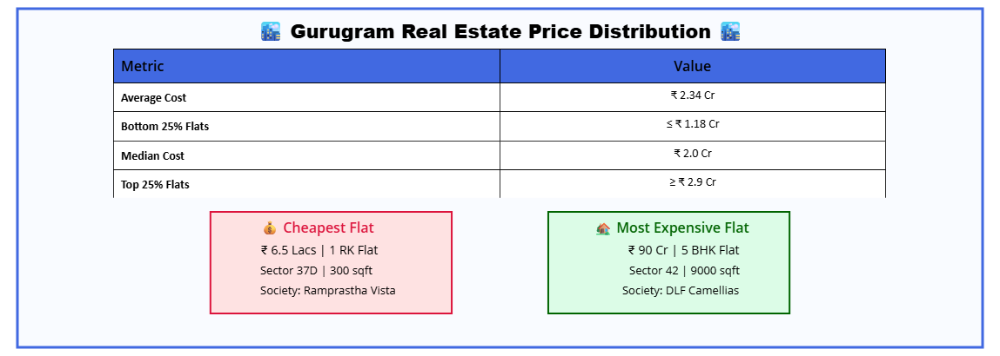

In [19]:
def price_data_card():
    ## Creating data card for "Price" Feature:
    fig = go.Figure()
    
    ## Card background
    fig.add_shape(type="rect", x0=0, y0=0, x1=1, y1=1, line=dict(color="royalblue", width=3),
                  fillcolor="#f9fbff", layer="below")
    
    ## ---- Title ----
    fig.add_annotation(text="🏙️ Gurugram Real Estate Price Distribution 🏙️", x=0.5, y=0.98, showarrow=False,
        font=dict(size=22, color="black", family="Arial Black"), xanchor="center")
    
    ## ---- KPI Table ----
    stats = [("Average Cost", "₹ 2.34 Cr"),("Bottom 25% Flats", "≤ ₹ 1.18 Cr"),
             ("Median Cost", "₹ 2.0 Cr"),("Top 25% Flats", "≥ ₹ 2.9 Cr")]
    
    fig.add_trace(go.Table(header=dict(values=["<b>Metric</b>", "<b>Value</b>"],
                    fill_color="royalblue", font=dict(color="black", size=16),
                    align=["left", "center"], line_color="black", line_width=1, height=20),
        cells=dict(values=[[f"<b>{s[0]}</b>" for s in stats],[f"{s[1]}" for s in stats]],
                   fill_color="white", font=dict(color="black", size=14, family="Calibri"),
                   align=["left", "center"], line_color="black", line_width=0.8, height=20),
        domain=dict(x=[0.1, 0.9], y=[0.44, 0.88]) ))
    
    # ---- Cheapest Flat Card ----
    fig.add_shape(type="rect", x0=0.20, y0=0.10, x1=0.45, y1=0.40, line=dict(color="crimson", width=2), 
                  fillcolor="#fee2e2", layer="below")
    
    fig.add_annotation(text="💰 <b>Cheapest Flat</b>",x=0.25, y=0.32, showarrow=False,
                       font=dict(size=16, color="crimson"))
    
    fig.add_annotation(text="₹ 6.5 Lacs | 1 RK Flat", x=0.25, y=0.26, showarrow=False,
                       font=dict(size=14, color="black"))
    
    fig.add_annotation(text="Sector 37D | 300 sqft", x=0.25, y=0.20, showarrow=False,
                       font=dict(size=13, color="black"))
    
    fig.add_annotation(text="Society: Ramprastha Vista", x=0.25, y=0.14, showarrow=False,
                       font=dict(size=13, color="black"))
    
    # ---- Most Expensive Flat Card ----
    fig.add_shape(type="rect", x0=0.55, y0=0.10, x1=0.80, y1=0.40, line=dict(color="darkgreen", width=2),
                  fillcolor="#dcfce7", layer="below")
    
    fig.add_annotation(text="🏡 <b>Most Expensive Flat</b>", x=0.76, y=0.32, showarrow=False,
                       font=dict(size=16, color="darkgreen"))
    
    fig.add_annotation(text="₹ 90 Cr | 5 BHK Flat", x=0.75, y=0.26, showarrow=False,
                       font=dict(size=14, color="black"))
    
    fig.add_annotation(text="Sector 42 | 9000 sqft", x=0.75, y=0.20, showarrow=False,
                       font=dict(size=13, color="black"))
    
    fig.add_annotation(text="Society: DLF Camellias", x=0.75, y=0.14, showarrow=False,
                       font=dict(size=13, color="black"))
    
    # ---- Layout cleanup (tight + no scrollbars) ----
    fig.update_xaxes(visible=False, range=[0, 1])
    fig.update_yaxes(visible=False, range=[0, 1])
    
    fig.update_layout(width=980, height=410,   # fixed size => no scrolling
                      autosize=False, margin=dict(l=20, r=20, t=10, b=10),
                      plot_bgcolor="white", paper_bgcolor="white")
    fig.show()

price_data_card()

<br>

---
# **`A.` Distribution of Property Price for 5 Major Flat Types?**

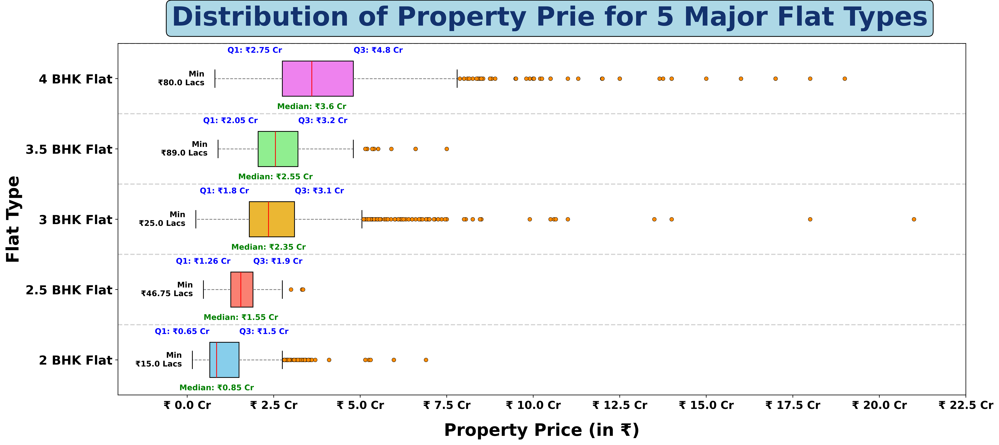

In [31]:
def Distribution_of_Property_Price_for_5_Major_Flat_Types():
    ## Preparing data for analysis: 
    five_maj_ft = ["2 BHK Flat", "2.5 BHK Flat", "3 BHK Flat",  "3.5 BHK Flat", "4 BHK Flat"]
    
    data = []    ## List of lists of Flat prices...
    for i in five_maj_ft:
        data.append(df[(df['Flat'] == i) & (df['Price_in_rupees'] <= 25e7)]['Price_in_rupees'].values)

    ## Creating plot: --------------------------------------------------------------------------------
    fig = plt.figure(figsize = (18,8), dpi = 500)
    ax = fig.add_subplot(1,1,1)
    box = ax.boxplot(data, vert = False, patch_artist=True)
    
    fig.suptitle("Distribution of Property Price for 5 Major Flat Types" , 
                  fontweight = 'bold', fontsize = 34, color = '#13326E', ha='center', x=0.55, y=0.99,
                 bbox={'facecolor': 'lightblue', 'edgecolor': 'black','boxstyle': 'round, pad=0.2', 
                       'linewidth': 1})
    
    colors = ['skyblue', 'salmon', '#EBB733','lightgreen', 'violet']
    
    for patch, color in zip(box['boxes'], colors):
        patch.set_facecolor(color)
        patch.set_edgecolor('black')
        patch.set_linewidth(1)
    
    # Customize median lines
    for median in box['medians']:
        median.set_color('red')
        median.set_linewidth(1)
    
    # Customize whiskers
    for whisker in box['whiskers']:
        whisker.set_linestyle('--')
        whisker.set_color('gray')
    
    # Customize caps
    for cap in box['caps']:
        cap.set_color('black')
    
    # Customize fliers (outliers)
    for flier in box['fliers']:
        flier.set(marker='o', markerfacecolor='darkorange', markersize=5, markeredgecolor='black',
        markeredgewidth=0.4)
    
    ## Annotate quantiles:
    annot_info = []
    for i in range(len(data)):
        q1 = np.percentile(data[i], 25)
        q2 = np.percentile(data[i], 50)  # median
        q3 = np.percentile(data[i], 75)
        qmin = np.min(data[i])
        annot_info.append(tuple([i+1, q1, q2, q3, qmin]))
    
    for i, q1, q2, q3, qmin in annot_info:
        ax.text(qmin - 3000000, i, f'Min\n₹{round(qmin/100000, 2)} Lacs', va='center', ha='right', color='black', fontweight='bold')
        ax.text(q1 - 100000, i + 0.4, f'Q1: ₹{round(q1/10000000, 2)} Cr', va='center', ha='right', color='blue', fontweight='bold')
        ax.text(q2, i - 0.4, f'Median: ₹{round(q2/10000000, 2)} Cr', va='center', ha='center', color='green', fontweight='bold')
        ax.text(q3 + 100000, i + 0.4, f'Q3: ₹{round(q3/10000000, 2)} Cr', va='center', ha='left', color='blue', fontweight='bold')
        plt.axhline(i + 0.5 , c='lightgrey', linestyle = '--')
    
    # Customize with Matplotlib
    ax.set_xlabel("Property Price (in ₹)", fontsize=22, fontweight='bold', labelpad=15)
    ax.set_ylabel("Flat Type", fontsize=22, fontweight='bold')
    ax.set_yticks(list(range(1,len(five_maj_ft)+1)))
    ax.set_yticklabels(five_maj_ft , fontsize=16,  fontweight='bold')
    ax.set_xlim(-20000000, 225000001)
    ax.set_xticks(list(np.linspace(0,225000001, 10)))
    ax.set_xticklabels(['₹ ' + str(round(i/10000000, 2)) + ' Cr' for i in np.linspace(0,225000001, 10)],
                       fontsize=14,  fontweight='bold')
    
    plt.tight_layout()
    plt.show()

Distribution_of_Property_Price_for_5_Major_Flat_Types()

### **`🔍 OBSERVATIONS :`**
* **2 BHK Flats:** Entry point as low as ₹15 Lakhs; median around ₹0.85 Cr; outliers reaching up to ~₹7 Cr.
* **2.5 BHK Flats:** **More compact distribution**; median ~₹1.55 Cr; **very few extreme outliers**.
* **3 BHK Flats:** Median ~₹2.35 Cr; **widest spread** with **very high outliers** (>₹20 Cr).
* **3.5 BHK Flats:** Median ~₹2.55 Cr; fairly **stable distribution with moderate outliers**.
* **4 BHK Flats:** Median ~₹3.6 Cr; **interquartile range is higher but consistent**; luxury outliers beyond ₹15 Cr.
* **Overall Trend**: As flat size increases, **median property prices rise significantly**, with price **distributions becoming wider and more skewed due to luxury outliers**.


### **`💡 Interpretation`**
* **2 BHKs** serve as the **entry-level housing segment**, appealing to budget-conscious buyers, **though some premium 2 BHKs exist in luxury localities**.
* **2.5 BHK & 3 BHKs** dominate the **mid-market family housing segment**, showing a balance between affordability and space.
* **3.5 & 4 BHKs** represent the **premium/luxury housing category**, with consistently higher medians and large spreads, reflecting diverse offerings from upper-mid to ultra-luxury apartments.
* The large number of **outliers in 3 BHK and 4 BHK** indicates **strong luxury demand** and **price heterogeneity within these categories**.


### **`🎯 Implication for Stakeholders`**
* **Developers:**
  * Should prioritize **2.5 & 3 BHK projects** as they represent the **most balanced and in-demand segment**.
  * Can **position 4 BHKs** as **luxury products in premium corridors** (e.g., Golf Course Road, MG Road).
  * Entry-level **2 BHK housing** still has strong demand among first-time buyers and investors.
* **Buyers:**
  * **Budget buyers** should focus on 2 BHKs in emerging areas.
  * **Families upgrading homes** may find value in 2.5 & 3 BHKs.
  * **Luxury buyers** have wide choices in 3.5 & 4 BHKs, **but must be aware of price variability**.
* **Investors:**
  * **Mid-segment flats (2.5 & 3 BHK)** likely **offer the best liquidity** and **resale potential**.
  * **High-value outliers** suggest opportunities in luxury resale, though with **higher risk and niche buyer demand**.

---

### **`✅ CONCLUSION :`**
The data highlights a **clear price stratification by flat type** in Gurugram’s housing market.
* **2 BHKs** form the **affordable entry point**.
* **2.5 & 3 BHKs** dominate the **mainstream segment with healthy spreads**.
* **3.5 & 4 BHKs** are **positioned as luxury**, attracting both affluent buyers and investors seeking high-end appreciation.

For stakeholders, this reinforces the **dual-market dynamic** — **affordable mass housing vs. premium luxury demand**, with the **2.5 & 3 BHK category emerging as the sweet spot** ***for balanced growth and investment***.

<br><br>

---
# **`B.` Price Buckets VS Number of Property listings?**
- Total Price Range of Gurugram Flats is humongous (~ ₹89.94 Cr) so we better split Properties into 2 categories and then create Price Buckets for the two categories.
    - **Category 1:** Property with Price ***≤ ₹5 Cr***
    - **Category 2:** Property with Price ***> ₹5 Cr***

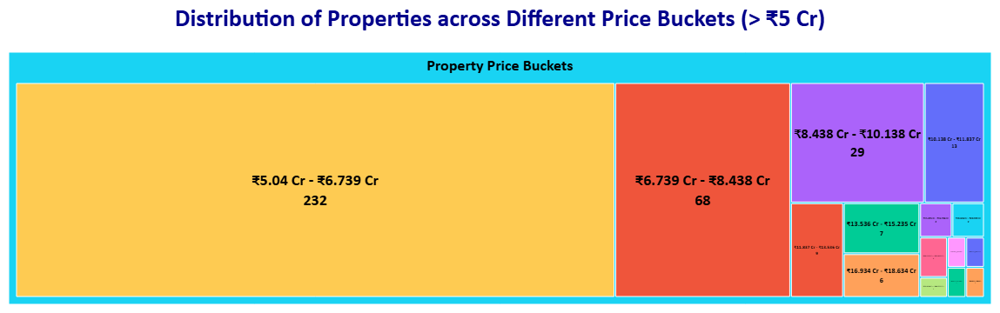

In [85]:
def Price_Buckets_VS_Number_of_Property_listings_cate1():
    ## Preparing data for Plot:
    ## Price range: 0 to 5 cr
    prices = df[df['Price_in_rupees'] <= (5e7)]['Price_in_rupees']     
    counts, bin_edges = np.histogram(prices, bins = 50)
    
    bins = ["₹" + str(round(bin_edges[i] / 1e7 , 3)) + " Cr - " + 
            "₹" + str(round(bin_edges[i+1] / 1e7 , 3)) + " Cr" for i in range(len(bin_edges) - 1)]
    
    ## ------------------------------------------------------------------------------------------------
    ## Creating Plot: 
    fig = plt.figure(figsize = (22,8), dpi = 700)
    ax = fig.add_subplot(1,1,1)
    bbox={'facecolor': 'lightblue', 'edgecolor': 'black','boxstyle': 'round, pad=0.2', 'linewidth': 1}
    
    ax.bar(height = counts, x = bins, color='#40E0D0', linewidth=1, edgecolor='black',
           label = 'Total Property Count in Price Bucket')
    
    ax.set_title('Distribution of Properties across Different Price Buckets (≤ ₹5 Cr)', 
                 fontsize=26, fontweight='bold', bbox = bbox, pad = 20)
    ax.set_ylabel('Total Property Count', fontsize=16, fontweight='bold')
    
    ax.set_ylim(0,630)
    ax.set_xlim(-1, 50)
    ax.get_xaxis().set_visible(False) 
    ax.legend(fontsize=18)
    
    ## Annoting Text:
    for i, height, label in zip(range(50), counts, bins):
            ax.text(i, height + 80, label, va='center', ha='center', color='black', fontsize=9,
                    fontweight='bold', rotation = 90)
            ax.text(i, height - 10, height, va='center', ha='center', color='black', fontsize=8,
                    fontweight='bold', rotation = 0)
    
    plt.show()

## ---------------------------------------------------------------------------------------------------
def Price_Buckets_VS_Number_of_Property_listings_cate2():
    ## Properties with Prices: > 5cr
    prices_rest = df[df['Price_in_rupees'] > (5e7)]['Price_in_rupees']     
    counts_rest, bin_edges_rest = np.histogram(prices_rest, bins = 50)
    
    bins_rest = ["₹" + str(round(bin_edges_rest[i] / 1e7 , 3)) + " Cr - " + 
                 "₹" + str(round(bin_edges_rest[i+1] / 1e7 , 3)) + " Cr" 
                 for i in range(len(bin_edges_rest) - 1)]
    
    ## Creating Series then DF for Plotly Treemap:
    bin_ser = pd.Series()
    for i, count in zip(range(50), counts_rest):
        bin_ser = pd.concat([bin_ser, pd.Series([bins_rest[i]] * count)])
    
    data = pd.DataFrame(bin_ser, columns = ['Price Range'])
    
    ## -----------------------------------------------------------------------------------------
    ## Creating a TreeMap:
    fig = px.treemap(data, path=[px.Constant('Property Price Buckets'),'Price Range'], 
                     values = pd.Series(np.ones(bin_ser.size)).astype('int8'),
                     color = 'Price Range' , color_continuous_scale='Plasma', # change color palette
                    )
    
    fig.update_layout(autosize=True, margin=dict(l=10, r=10, t=60, b=10),
              title=dict(
                  text="<b>Distribution of Properties across Different Price Buckets (> ₹5 Cr)</b>",
                  font=dict(size=28, color="darkblue", family='Calibri'),
                  x = 0.5,  # center title
                  pad=dict(t=50, b=0, l=20, r=20)), paper_bgcolor='white')
    
    fig.update_traces(textinfo="label+value",
                      # textinfo="label+percent parent",
                      hovertemplate='<b>Price Bucket: %{label}</b><br>Prop. Count: %{value}<br><extra></extra>',
                      textfont=dict(size=18, color="black", family="Calibri black"),
                      textposition="middle center",
                      tiling=dict(pad=2))
    
    fig.show()


Price_Buckets_VS_Number_of_Property_listings_cate1()
Price_Buckets_VS_Number_of_Property_listings_cate2()

### **`🔍 OBSERVATIONS :`**
* **Most properties are priced below** **₹2 Cr**.
* **Highest concentration** can be observed **between** **₹0.50 Cr – ₹2.85 Cr**.
* **Property count gradually declines as price increases**, with **noticeable dips beyond ₹3 Cr**.
* Properties above **₹5 Cr** represent a **much smaller share**, with the **majority clustered** between **₹5 Cr – ₹7 Cr**.
* **Very few properties exist in** the **ultra-luxury segment (>₹10 Cr)**.


### **`💡 Interpretation`**
* The **Gurgaon real estate market** is **dominated by mid-segment housing (₹0.5 Cr – ₹2 Cr)**, which suggests a strong demand in the affordable-to-moderate range.
* The **luxury and ultra-luxury segments (>₹5 Cr)** ***exist but are niche***, indicating limited supply and targeted buyers.
* The **sharp decline** in counts **after ₹3 Cr** reflects ***affordability constraints*** and a ***smaller buyer pool for high-value properties***.


### **`🎯 Implication for Stakeholders`**
* **Buyers:** **Greater availability** in the mid-price range gives **more choices and negotiating power** to buyers.
* **Investors:** **Mid-segment properties** provide **higher liquidity and faster turnover**, while premium segments may offer exclusivity but slower transactions.
* **Developers:** There is significant scope in **affordable and moderate housing projects**, while luxury projects should be positioned carefully in high-demand micro-markets.
* **Policy Makers/Planners:** Need to ensure adequate infrastructure and amenities in affordable clusters to sustain livability.

---

### **`✅ CONCLUSION :`**
**Gurgaon property market** is **heavily skewed toward** ***affordable to moderate housing (≤ ₹2 Cr)***, reflecting broader demand patterns of the city. 
+ **While luxury and ultra-luxury properties exist**, they form a **niche market** with **limited buyers**.
+ For sustainable growth, **stakeholders should focus** on strengthening the **affordable and mid-segment housing** while **maintaining a premium edge** in **select high-demand sectors**.

<br><br>

---
# **`C.` Is there any correlation between 'Property Price' and Built-up Area (in Sq.ft)?**
- **Analyse using scatter plot** to see, relation between Property Price and Property Area.
- **Keep the outliers Property Listings away from the plot**.
- Consider properties upto the Price of ₹25 Cr.
- Analyse relationship and quantify it using **"t-test for Pearson Correlation Coefficient"**, a correlation test to check the statistical significance of Pearson Correlation Score. 

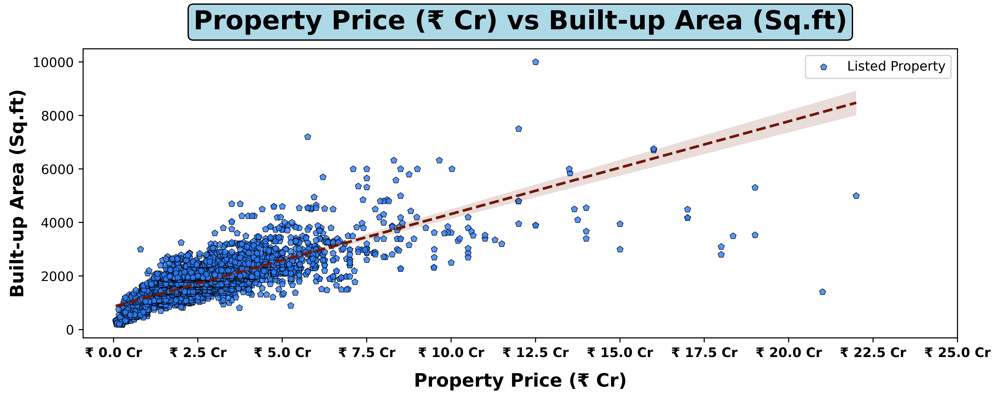

In [122]:
def Property_Price_VS_Builtup_Area():
    ## Preparing data:
    data = df[df['Price_in_rupees'] < 2.5e8]
    
    ## Creating scatter plot: ---------------------------------------------------------------------------
    fig = plt.figure(figsize = (12,4), dpi = 500)
    ax = fig.add_subplot(1,1,1)
    bbox={'facecolor': 'lightblue','edgecolor': 'black','boxstyle': 'round, pad=0.2','linewidth': 1}
    
    ax = sns.regplot(data=data, x = 'Price_in_rupees', y = 'Built_up_area_in_sqft', color = '#2B7FFF',
                     label = 'Listed Property', marker = 'p',
                     scatter_kws={'s': 25, 'edgecolor': 'black', 'linewidths': 0.5},
                     line_kws={'color': '#701705', 'lw': 2, 'ls': '--'}) 
    
    ax.set_xlim(-9000000, 2.5e8)
    ax.set_xticks(np.linspace(0, 2.5e8, 11))
    ax.set_xticklabels(["₹ " + str(i/10000000) + " Cr" for i in np.linspace(0, 2.5e8, 11)], 
                       fontweight='bold')
    
    ax.set_title('Property Price (₹ Cr) vs Built-up Area (Sq.ft)', fontsize=20, fontweight='bold',
                 bbox = bbox, pad = 15)
    ax.set_ylabel('Built-up Area (Sq.ft)', fontsize=14, fontweight='bold')
    ax.set_xlabel('Property Price (₹ Cr)', fontsize=14, fontweight='bold', labelpad=10)
    ax.legend()
    
    plt.show()

Property_Price_VS_Builtup_Area()

In [124]:
## t-test for Pearson Correlation coefficient:
from scipy.stats import pearsonr
data = df[df['Price_in_rupees'] < 2.5e8]

r, p_value = pearsonr(data['Price_in_rupees'], data['Built_up_area_in_sqft'])
print(f"Pearson Correlation Coefficient r: {r:.5f}, p-value: {p_value:.6f}\n")

Pearson Correlation Coefficient r: 0.78842, p-value: 0.000000



### **`🔍 OBSERVATIONS :`**
* Scatter plot shows a **positive linear relationship** between **Property Price (₹ Cr)** and **Built-up Area (Sq.ft)**.
* **Larger built-up areas** tend to **correspond to higher property prices**.
* There is **visible variance** in higher price ranges, where **properties with similar areas are priced differently**.
* Pearson correlation coefficient **r = 0.788** indicates a **strong positive correlation** between price and built-up area.
* The **p-value ≈ 0.000000** suggests the **correlation is** ***statistically significant***.


### **`💡 Interpretation`**
* Property price is **strongly driven by the size (built-up area)**, but **other factors** (location, sector, amenities, builder reputation) **also influence variation**.
* The **scatter widening at higher price brackets** reflects **Premium Pricing**, where ***factors beyond size drive costs*** (e.g., luxury projects, branded developments).
* Strong correlation confirms that **built-up area is a reliable predictor** for property price modeling, **but not the sole determinant**.


### **`🎯 Implication for Stakeholders`**
* **Buyers:** Larger built-up areas generally command higher prices, but **premium pricing beyond size should be carefully assessed** before purchase.
* **Developers:** Emphasizing **efficient space utilization** and **value-add features** (like amenities and location branding) **can justify premium pricing above area-driven value**.
* **Investors:** **Built-up area** is a **strong metric for estimating value**, making it a useful **benchmark for property comparisons and ROI assessments**.
* **Policy Makers/Planners:** Strong size-price linkage underlines the need to ensure **balanced development of affordable housing units**, as size inflation directly impacts affordability.

---

### **`✅ CONCLUSION :`**
There exists a **statistically significant and strong positive relationship** between property prices and built-up areas in Gurugram. While **built-up area** is a **primary driver** of price, **non-physical factors (location, brand, luxury appeal)** add substantial variation **at higher price points**. This insight helps stakeholders balance affordability, demand, and premium pricing strategies.

<br><br>

---
# **`D.` Relation between Property Price and Built-up Area across 5 Major Flat Types?**

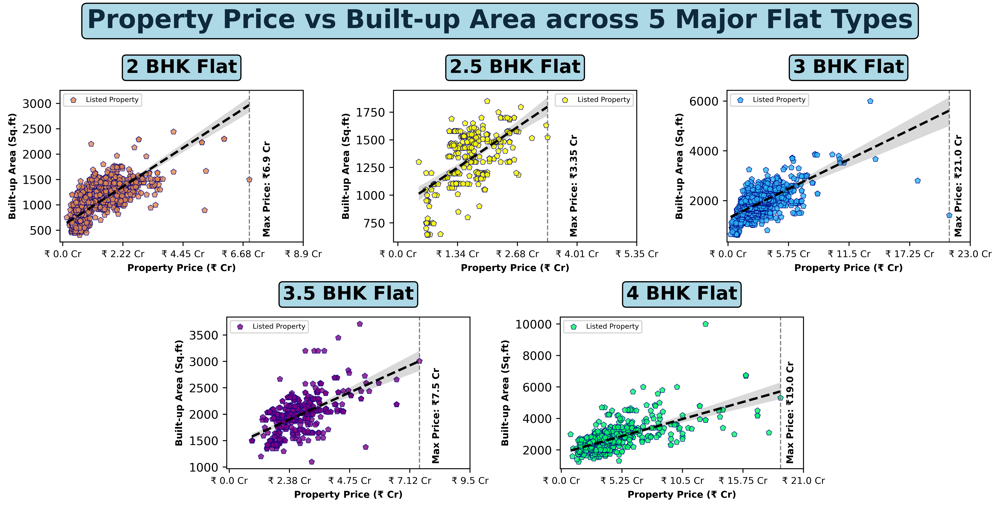

In [151]:
def Property_Price_VS_Builtup_Area_5_major_Flats():
    ## Creating Plot: ------------------------------------------------------------------------------------
    five_maj_ft = ["2 BHK Flat", "2.5 BHK Flat", "3 BHK Flat",  "3.5 BHK Flat", "4 BHK Flat"]
    
    fig = plt.figure(figsize = (12,6), dpi = 500)
    ax1 = fig.add_subplot(2,6,(1,2))
    ax2 = fig.add_subplot(2,6,(3,4))
    ax3 = fig.add_subplot(2,6,(5,6))
    ax4 = fig.add_subplot(2,6,(8,9))
    ax5 = fig.add_subplot(2,6,(10,11))
    
    axes = [ax1, ax2, ax3, ax4, ax5]
    colors = ['#E1884C', 'yellow', '#29B6F6', 'purple', '#00FF66']
    
    bbox={'facecolor': 'lightblue',     # Background color
                       'edgecolor': 'black',         # Border color
                       'boxstyle': 'round, pad=0.2', # Rounded box, with padding
                       'linewidth': 1                # Border thickness
                      }
    
    fig.suptitle("Property Price vs Built-up Area across 5 Major Flat Types" , fontweight = 'bold', 
                 fontsize = 22, color = '#0D293B', ha='center', x=0.5, y=1.0, bbox=bbox)
    
    for ax, color, i in zip(axes, colors, range(5)):
        data = df[(df['Price_in_rupees'] < 2.5e8) & (df['Flat'] == five_maj_ft[i])]
    
        sns.regplot(data=data, x = 'Price_in_rupees', y = 'Built_up_area_in_sqft', color = color,
                         label = 'Listed Property', marker = 'p', ax = ax,
                         scatter_kws={'s': 25, 'edgecolor': 'navy', 'linewidths': 0.5},
                         line_kws={'color': 'black', 'lw': 2, 'ls': '--'}) 
        
        max_prop_price = data['Price_in_rupees'].max()
        
        ax.axvline(max_prop_price, color='grey', linestyle='--', linewidth=1) 
        ax.text(max_prop_price + 0.5e7, data['Built_up_area_in_sqft'].min() , 
               f'Max Price: ₹{max_prop_price/10000000} Cr', rotation = 90, fontsize = 8, fontweight='bold')
    
        ax.set_xlim(-1000000, max_prop_price + 2e7)
        ax.set_xticks(np.linspace(0, max_prop_price + 2e7, 5))
        ax.set_xticklabels(["₹ " + str(round(i/10000000, 2)) + " Cr" 
                            for i in np.linspace(0, max_prop_price + 2e7, 5)], fontsize = 8)
        
        ax.set_title(five_maj_ft[i], fontsize=16, fontweight='bold',
                     bbox = bbox, pad = 15)
        ax.set_ylabel('Built-up Area (Sq.ft)', fontsize=8, fontweight='bold')
        ax.set_xlabel('Property Price (₹ Cr)', fontsize=8, fontweight='bold')
        ax.legend(fontsize = 6)
    
    plt.tight_layout()
    plt.show()

Property_Price_VS_Builtup_Area_5_major_Flats()

### **`🔍 OBSERVATIONS :`**
* **2 BHK Flats**:
  * **Most listings** lie **between ₹0.5 Cr – ₹3 Cr** with **built-up area ~800–1500 sq.ft**.
  * Maximum observed price reaches ~₹6.9 Cr.
* **2.5 BHK Flats**:
  * **Price cluster between ₹1 Cr – ₹3 Cr** with **~1000–1500 sq.ft area**.
  * Maximum recorded price ~₹3.35 Cr.
* **3 BHK Flats**:
  * **Very wide distribution**, prices mostly in the **₹1.5 Cr – ₹5 Cr range**.
  * Max outlier price goes up to ~₹21 Cr.
  * **Built-up area spans ~1200–4000+ sq.ft**.
* **3.5 BHK Flats**:
  * **Relatively smaller market** compared to 3 BHK and 4 BHK.
  * Prices generally **~₹2 Cr – ₹5 Cr** with max ~₹7.5 Cr.
  * Built-up area clustered **~1500–2500 sq.ft**.
* **4 BHK Flats**:
  * **Prices spread widely from ~₹2 Cr to beyond ₹15 Cr**.
  * Max price observed ~₹19 Cr.
  * **Large built-up areas of ~2500–8000+ sq.ft**.


### **`💡 Interpretation`**
* **Price grows systematically with flat size (BHK count)**, with 2 BHK being entry-level and 4 BHK/3 BHK being premium-heavy categories.
* **3 BHK Flats dominate the market** both in count and **price variation**, most demanded category.
* **4 BHK and luxury flats show higher price dispersion**, suggesting **significant premium** for amenities, brand, and location **beyond just size**.
* **2.5 BHK Flats have limited distribution** and serve as a niche between budget and mid-segment buyers.
* **Outliers** (very high-priced listings **for 3 BHK and 4 BHK**) highlight **luxury positioning in select micro-markets**.


### **`🎯 Implication for Stakeholders`**
* **Developers:**
  * Should **focus supply on 3 BHK & 4 BHK categories** as they show strong demand and premium potential.
  * Affordable housing projects can target the 2 BHK range where volume demand exists.
  * Differentiation (luxury amenities, gated communities) is crucial in the high-end 4 BHK space.
* **Investors:**
  * 3 BHK flats provide **better liquidity** in resale and rental markets due to wide demand.
  * 2 BHK properties are safe bets for **affordable rental yields**.
  * 4 BHK flats, **though riskier**, can yield **higher appreciation in luxury clusters**.

---

### **`✅ CONCLUSION :`**
The analysis **clearly shows** a **direct correlation between flat type (BHK) and property price**, with 3 BHK flats emerging as the most dominant and versatile segment in Gurugram. **2 BHKs cater to affordability, 2.5 BHKs serve as transitional homes, 3 BHKs dominate the mid-to-high segment, while 4 BHKs occupy the luxury premium niche.** For stakeholders, aligning pricing strategies, development plans, and investment portfolios with these demand clusters will maximize both sales potential and long-term value creation.

---

**`NOTE :`** Since there is clear positive relation between Price and Built-up Area, their is no need to study relationship between "Price" and "Property Price Per Sq.ft", because that will also show positive relation. Property Price Per Sq.ft is nothing but ratio of Property Price and Built-up Area.

<br><br>

----
# **`E.` Is there a Standrad Price-to-Built-up-Area Ratio, or are there irregularities?**
- Let's analyse "Property Price Density (₹/Sq.ft)" feature which is nothing but a ratio of Price and Built-up Area.
- Just check if across properties, we have a constant or near constant 'Property Price Density (₹/Sq.ft)'.

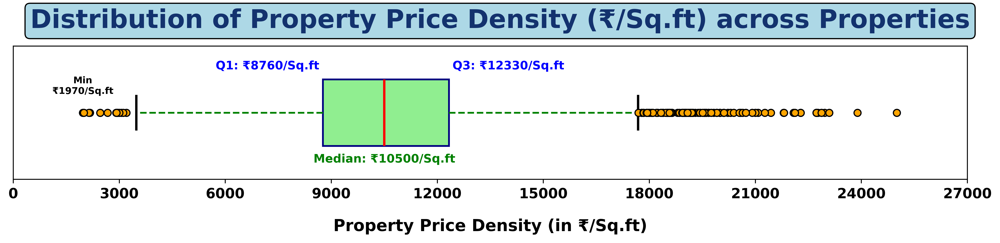

In [46]:
def Which_Sectors_are_expensive_and_which_are_economical_to_buy():
    ## Preparing data for anlaysis:
    data = df[df['Price_in_rupees'] <= 2.5e7]
    data = data['Avg_price_rupee_per_sqft'].dropna()
    
    ## Creating plot: -----------------------------------------------------------------------------------
    fig = plt.figure(figsize = (12,3), dpi = 500)
    ax = fig.add_subplot(1,1,1)
    ax.boxplot(x = data, vert = False, patch_artist=True, widths = [0.5],
                    boxprops=dict(facecolor="lightgreen", color="navy", linewidth=1.5),
                    whiskerprops=dict(color="green", linewidth=1.5, linestyle='--'),
                    capprops=dict(color="black", linewidth=2),     # top/bottom caps
                    medianprops=dict(color="red", linewidth=2),    # median line
                    flierprops=dict(marker='o', markerfacecolor="orange", markersize=6, linestyle="none"))
    
    fig.suptitle("Distribution of Property Price Density (₹/Sq.ft) across Properties", fontweight = 'bold',
                 fontsize = 22, color = '#13326E', ha='center', x=0.5, y=0.95,
                 bbox={'facecolor': 'lightblue','edgecolor': 'black','boxstyle': 'round, pad=0.2',
                       'linewidth': 1})
    
    ## Annotation of Quartiles:
    q1 = np.percentile(data, 25)
    q2 = np.percentile(data, 50)  # median
    q3 = np.percentile(data, 75)
    qmin = np.min(data)
    
    ax.text(qmin, 1 + 0.20, f'Min\n₹{int(qmin)}/Sq.ft', va='center', ha='center', color='black', fontweight='bold', fontsize=8)
    ax.text(q1 - 100, 1 + 0.35, f'Q1: ₹{int(q1)}/Sq.ft', va='center', ha='right', color='blue', fontweight='bold')
    ax.text(q2, 1 - 0.35, f'Median: ₹{int(q2)}/Sq.ft', va='center', ha='center', color='green', fontweight='bold')
    ax.text(q3 + 100, 1 + 0.35, f'Q3: ₹{int(q3)}/Sq.ft', va='center', ha='left', color='blue', fontweight='bold')
    
    # Customize with Matplotlib
    ax.set_xlabel("Property Price Density (in ₹/Sq.ft)", fontsize=14, fontweight='bold', labelpad=15)
    ax.get_yaxis().set_visible(False) 
    ax.set_xlim(0, 27001)
    ax.set_xticks(list(np.arange(0,27001, 3000)))
    ax.set_xticklabels(np.arange(0,27001, 3000) , fontsize=12,  fontweight='bold')
    
    plt.tight_layout()
    plt.show()

Which_Sectors_are_expensive_and_which_are_economical_to_buy()

### **`🔍 OBSERVATIONS :`**
* **Median Price Density:** ~₹10,500/Sq.ft
* **IQR (Interquartile Range):** **₹8,760/Sq.ft (Q1) to ₹12,330/Sq.ft (Q3)** → shows the central “standard” range.
* **Minimum Value:** ~₹1,970/Sq.ft → **very low compared to the median**.
* **Outliers:** **Significant presence** on the higher side (₹18,000 – ₹25,000+/Sq.ft), **indicating premium or luxury properties**.


### **`💡 Interpretation`**
* The **central tendency (₹8.7K – ₹12.3K/Sq.ft)** suggests a **standard benchmark range** for most properties in Gurugram.
* However, the **presence of very low values (\~₹2K/Sq.ft)** indicates underpriced or **possibly distressed/affordable housing** projects.
* On the other hand, **extreme high outliers (₹18K – ₹25K/Sq.ft)** reflect **luxury, branded residences, or prime-location projects**.
* Thus, while a **“typical price-to-built-up-area ratio”** exists around **₹9K–₹12K/Sq.ft**, the market is **NOT uniform** and shows **STRONG irregularities at both ends**.


### **`🎯 Implication for Stakeholders`**
* **Homebuyers:** Can **rely on the ~₹9K–₹12K/Sq.ft range as a reference benchmark**, but **must evaluate whether** a **listed property is genuinely premium** (if above ₹18K/Sq.ft) **or risk-laden** (if below ₹5K/Sq.ft).
* **Developers:** Should position projects carefully—**mass market offerings should stay within the benchmark range**, while **luxury projects must justify higher densities with amenities, brand value, and location**.
* **Investors:** Opportunity to exploit **irregularities**—low-density priced properties may offer undervalued investment, while luxury outliers need careful risk-return analysis.

---

### **`✅ CONCLUSION :`**
**YES**, there is a **Standard Price-to-Built-up-Area Ratio for Gurugram flats (~₹9K–₹12K/Sq.ft)** which **represents the mainstream market**.
BUT the **market also displays clear irregularities**: extremely low-priced properties (possibly affordable or distressed) and high-end outliers (>₹18K/Sq.ft) representing luxury or niche demand. This highlights that **Gurugram real estate is segmented and heterogeneous** rather than following one uniform price-to-area ratio.

**Pricing, negotiation, and valuation should be context-specific** rather than relying on a universal ratio, **given** the **evident irregularities** and **premium housing clusters**.

<br><br>

---
# **`F.` What is the relation between "Price Bucket" and "Per-bedroom Cost"?**
So the question is: `👉 If we group properties by their Price and make "Price Buckets" , what is the aggregated "Price Per Bedroom" of each Price Bucket?` This gives insights like:
- Do higher-priced properties give more value per bedroom?
- In mid-range properties, Per Bedroom Cost is inflated compared to luxury ones?
- How does cost efficiency (price per bedroom) change with overall property price?

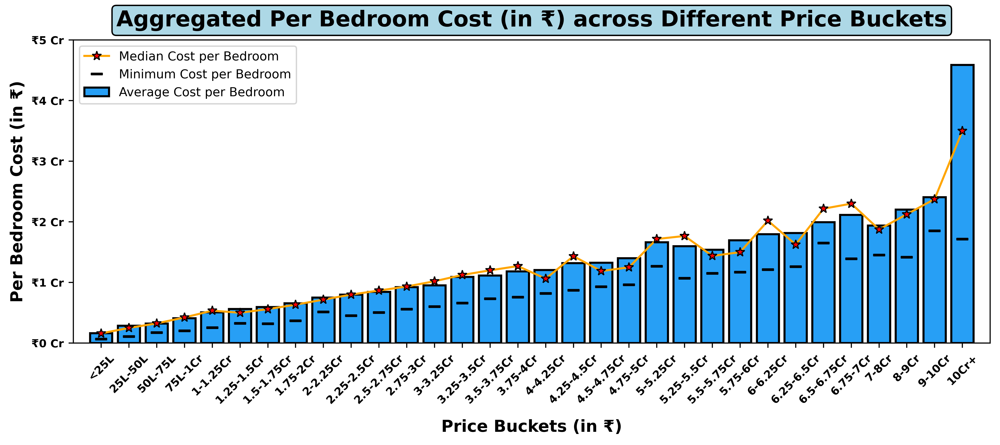

In [70]:
def Price_Bucket_VS_Per_bedroom_Cost():
    ## Preparing data for Plot:
    # Binning "Property Prices" into fixed ranges
    bins = [0, 25e5, 50e5, 75e5, 1e7, 125e5, 150e5, 175e5, 2e7, 
            225e5, 250e5, 275e5, 3e7, 325e5, 350e5, 375e5, 4e7, 
            425e5, 450e5, 475e5, 5e7, 525e5, 550e5, 575e5, 6e7,
            625e5, 650e5, 675e5, 7e7, 8e7, 9e7, 10e7, float('inf')]
    
    labels = ['<25L','25L-50L', '50L-75L', '75L-1Cr', '1-1.25Cr', '1.25-1.5Cr', '1.5-1.75Cr', '1.75-2Cr', 
              '2-2.25Cr', '2.25-2.5Cr', '2.5-2.75Cr', '2.75-3Cr',
              '3-3.25Cr', '3.25-3.5Cr', '3.5-3.75Cr', '3.75-4Cr',
              '4-4.25Cr', '4.25-4.5Cr', '4.5-4.75Cr', '4.75-5Cr',
              '5-5.25Cr', '5.25-5.5Cr', '5.5-5.75Cr', '5.75-6Cr',
              '6-6.25Cr', '6.25-6.5Cr', '6.5-6.75Cr', '6.75-7Cr',
              '7-8Cr', '8-9Cr', '9-10Cr', '10Cr+']
    
    ## Creating a Column in DF with "Price_buckets" label:
    df['Price_buckets'] = pd.cut(df['Price_in_rupees'], bins = bins, labels = labels)
    
    ## Grouping data based on the Price Buckets formed above and finding mean and median "Price/bedrooms" 
    ## for each of the group:
    def func_bed(data):
        pri_per_bed = data['Price_in_rupees'] / data['Bedrooms']
        return pd.Series([pri_per_bed.size, pri_per_bed.min(), pri_per_bed.max(), pri_per_bed.mean(), 
                          pri_per_bed.median()],
                         index = pd.MultiIndex.from_tuples([('Price_per_bedrooms', 'tot_prop_listed'), 
                                                            ('Price_per_bedrooms', 'min'), 
                                                            ('Price_per_bedrooms', 'max'),
                                                            ('Price_per_bedrooms', 'mean'), 
                                                            ('Price_per_bedrooms', 'median')]))
    
    data = df.groupby(by = 'Price_buckets').apply(func_bed).reset_index()
    
    ## ------------------------------------------------------------------------------------------------
    ## Creating Plot: 
    fig = plt.figure(figsize = (12,4), dpi = 500)
    ax = fig.add_subplot(1,1,1)
    bbox={'facecolor': 'lightblue', 'edgecolor': 'black', 'boxstyle': 'round, pad=0.2', 'linewidth': 1}
    
    ax.bar(height = data[('Price_per_bedrooms', 'mean')], x = data['Price_buckets'], 
           color='#279FF5', linewidth=1.5, edgecolor='black', label = 'Average Cost per Bedroom')
    
    ax.plot(data['Price_buckets'], data[('Price_per_bedrooms', 'median')], color='orange', linewidth=1.5, 
            label = 'Median Cost per Bedroom', marker = '*', markersize  = 7,  markerfacecolor='red',
            markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.plot(data['Price_buckets'], data[('Price_per_bedrooms', 'min')], linewidth=0, 
            label = 'Minimum Cost per Bedroom', marker = '$-$', markersize  = 8,  markerfacecolor='black',
            markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.set_title('Aggregated Per Bedroom Cost (in ₹) across Different Price Buckets', 
                 fontsize=16, fontweight='bold', bbox = bbox, pad = 10)
    ax.set_ylabel('Per Bedroom Cost (in ₹)', fontsize=12, fontweight='bold')
    ax.set_xlabel('Price Buckets (in ₹)', fontsize=12, fontweight='bold', labelpad=10)
    
    ax.set_xlim(-1, 32)
    ax.set_xticks(list(range(0, 32)))
    ax.set_xticklabels(data['Price_buckets'], rotation = 45, fontsize = 8, fontweight = 'bold')

    ax.set_ylim(0,5e7)
    ax.set_yticks(list(range(0, 50000001, 10000000)))
    ax.set_yticklabels([f"₹{i} Cr" for i in range(0, 6)], fontsize = 8, fontweight = 'bold')
    
    ax.legend(fontsize=9, loc='upper left')
    plt.show()

Price_Bucket_VS_Per_bedroom_Cost()

### **`🔍 OBSERVATIONS :`**
* **Rising Trend:** **Per bedroom cost** generally **increases with overall property price buckets**.
* **Low Buckets (<₹1 Cr):** Per bedroom cost **remains relatively low and consistent**, showing affordability.
* **Mid Buckets (₹1 Cr – ₹4 Cr):** **Steady** but moderate **rise in average and median** per bedroom cost.
* **Upper Buckets (₹4 Cr – ₹8 Cr):** **Noticeable jumps and fluctuations**, with sharper increases in certain bands (₹5–6 Cr, ₹6.5–7 Cr).
* **Luxury Segment (₹10 Cr+):** **Very steep spike** in per bedroom cost, exceeding ₹4 Cr/bedroom, well above all other buckets.
* **Median vs Average:** The median and average per bedroom costs **move closely together**, **implying balanced distribution without extreme skew** except in ultra-luxury ranges.


### **`💡 Interpretation`**
* **Affordability Plateau:** **Properties below ₹1 Cr provide cost-effective bedroom pricing**, likely catering to first-time buyers and middle-income households.
* **Value Progression:** **As property prices rise, per bedroom cost increases proportionally**, suggesting that *larger or more expensive properties command premium per-room valuations*.
* **Luxury Premium:** **Beyond ₹4 Cr, per bedroom cost grows disproportionately**, especially in ultra-luxury projects (₹10 Cr+), reflecting brand, exclusivity, and prime location influences.
* **Market Segmentation:** **Clear segmentation exists** — affordable (<₹1 Cr), mid-market (₹1–4 Cr), premium (₹4–8 Cr), and luxury (₹8 Cr+).


### **`🎯 Implication for Stakeholders`**
* **Homebuyers:**
  * **Affordable and mid-market buckets** provide the **best cost-per-bedroom value**.
  * Luxury buyers are paying a **steep premium per room**, often for lifestyle and brand rather than space efficiency.
* **Developers:**
  * **Should position projects strategically** — *affordable projects for volume buyers and luxury projects for high-margin returns*.
  * **Pricing strategies in the ₹5–8 Cr range need careful balancing** to avoid luxury buyers out while still capturing aspirational demand.
* **Investors:**
  * Mid-segment properties (~₹1–4 Cr) may yield better resale and rental potential due to efficiency in per bedroom cost.
  * Ultra-luxury (>₹10 Cr) is niche, appealing mainly for capital appreciation or prestige investment rather than liquidity.

---

### **`✅ CONCLUSION :`**
The analysis shows that **per bedroom cost rises steadily with overall property value but accelerates disproportionately in the luxury segment**. While **affordable and mid-market ranges maintain value efficiency**, **ultra-luxury properties command a significant brand/location premium per room**. This **underlines** the **segmented nature of Gurugram’s market**, where affordability, premium demand, and luxury exclusivity coexist, each requiring distinct buyer targeting and pricing strategies.

---

### **`ADDITIONAL QUESTIONS TO ANSWER :`**
#### **1️⃣ Do higher-priced properties give more value per bedroom?**
* **No.** Higher-priced properties generally **do not provide more value per bedroom**.
* **Instead**, they **command** a **premium per bedroom**, especially in the **luxury segment** (>₹8–10 Cr), **where costs per room rise disproportionately due to brand**, exclusivity, and location **rather than space efficiency**.

#### **2️⃣ In Mid-Range properties, is Per Bedroom Cost inflated compared to luxury ones?**
* **Not Exactly.** In the **mid-range (₹1–4 Cr)**, per bedroom cost **increases steadily** but remains relatively balanced.
* In luxury properties, **per bedroom cost is far higher** than mid-range ones (₹2–4 Cr/room vs. <₹1 Cr/room).
* So mid-range is **not inflated** compared to luxury; **rather**, it **offers better cost efficiency** and **higher value per bedroom**.

#### **3️⃣ How does cost efficiency (Price Per bedroom) change with overall property price?**
* **Affordable (<₹1 Cr):** **Highest cost efficiency** (*lowest ₹/bedroom*).
* **Mid-range (₹1–4 Cr):** Moderate and stable cost efficiency, **best balance between price and value**.
* **Premium (₹4–8 Cr):** Cost per bedroom rises significantly; **efficiency declines**.
* **Luxury (₹8–10 Cr+):** **Very low cost efficiency**, with steeply rising per bedroom costs due to luxury positioning.

---

#### ✅ **`SUMMARY :`**
* **Cost Efficiency declines as Property Price rises.**
* **Mid-range properties offer the best value per bedroom**, while **luxury properties are least efficient**, reflecting lifestyle and exclusivity premiums rather than proportional space value.

---

<br>

#### `To Prove: In Gurugram across properties, "Per-bedroom Cost" grows disproportionately w.r.t "Property Cost" due to Luxury Premium paid in Expensive Proeprties.`

In [302]:
## t-test for Pearson correlation coefficient:
from scipy.stats import pearsonr
per_bedroom_cost = df['Price_in_rupees'] / df['Bedrooms']

r, p_value = pearsonr(df['Price_in_rupees'], per_bedroom_cost)
print(f"Pearson Correlation Coefficient r: {r:.5f}, p-value: {p_value:.6f}")

Pearson Correlation Coefficient r: 0.94572, p-value: 0.000000


#### **`NOTE :`**
- The Pearson Correlation Coefficient between Property Price and Per-bedroom cost is **0.945** (p-value < 0.001), which means **there exist very strong positive relation**.
- Hence **this proves that acroos Properties, Per-bedroom cost does not remian constant and flat, and instead affected by 'Luxury Premium' paid by buyers over the properties**.

<br><br>

---
# **`G.` Is there any correlation between Property Price and Brokerage Cost?**
- What is the strength of Correaltion between two?
- If there is direct correlation, does a fixed percentage of Property Price forms the Brokerage Cost?

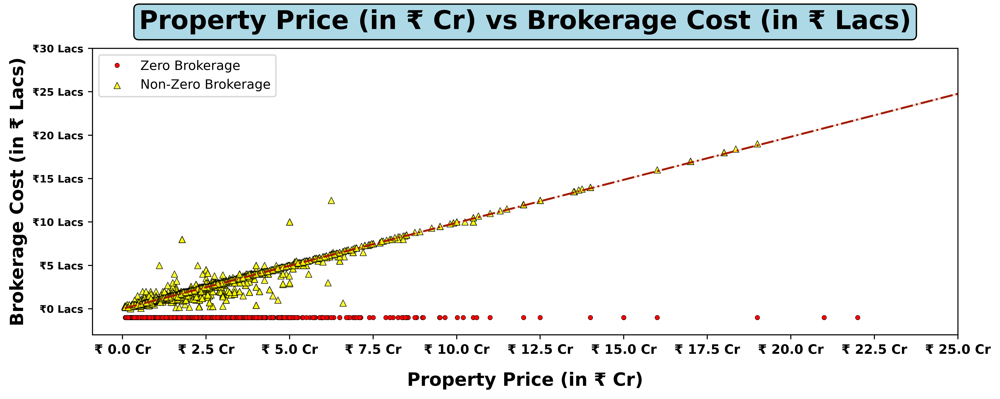

In [37]:
def Property_Price_VS_Brokerage():
    ## Preparing data:
    data = df[df['Brokerage_in_rupees'] != 0]
    data_ =  df[df['Brokerage_in_rupees'] == 0]
    
    ## Creating Plot: --------------------------------------------------------------------------------
    fig = plt.figure(figsize = (12,4), dpi = 500)
    ax = fig.add_subplot(1,1,1)
    bbox={'facecolor': 'lightblue',     # Background color
                       'edgecolor': 'black',         # Border color
                       'boxstyle': 'round, pad=0.2', # Rounded box, with padding
                       'linewidth': 1                # Border thickness
                      }
    
    ax.plot(data_['Price_in_rupees'], data_['Brokerage_in_rupees'] + -1e5, linewidth=0, 
            label = 'Zero Brokerage', marker = '.', markersize  = 7,  markerfacecolor='red',
            markeredgecolor='black', markeredgewidth = 0.3)
    
    ax = sns.regplot(data=data, x = 'Price_in_rupees', y = 'Brokerage_in_rupees', color = '#FFFF00',
                     label = 'Non-Zero Brokerage', marker = '^',
                     scatter_kws={'s': 25, 'edgecolor': 'black', 'linewidths': 0.5},
                     line_kws={'color': '#A31B00', 'lw': 1.5, 'ls': '-.'}) 
    
    
    ax.set_ylim(-3e5,30e5)
    ax.set_yticks(list(range(0, 3000001, 500000)))
    ax.set_yticklabels([f"₹{i} Lacs" for i in range(0, 31, 5)], fontsize = 8, fontweight = 'bold')
    
    ax.set_xlim(-9000000, 2.5e8)
    ax.set_xticks(np.linspace(0, 2.5e8, 11))
    ax.set_xticklabels(["₹ " + str(i/10000000) + " Cr" for i in np.linspace(0, 2.5e8, 11)], 
                       fontweight = 'bold')
    
    ax.set_title('Property Price (in ₹ Cr) vs Brokerage Cost (in ₹ Lacs)', fontsize=20, fontweight='bold',
                 bbox = bbox, pad = 15)
    ax.set_ylabel('Brokerage Cost (in ₹ Lacs)', fontsize=14, fontweight='bold')
    ax.set_xlabel('Property Price (in ₹ Cr)', fontsize=14, fontweight='bold', labelpad = 12)
    ax.legend(loc = 'upper left')
    
    plt.show()

Property_Price_VS_Brokerage()

In [17]:
## t-test for Pearson correlation coefficient:
from scipy.stats import pearsonr
data = df[df['Brokerage_in_rupees'] != 0]

r, p_value = pearsonr(data['Price_in_rupees'], data['Brokerage_in_rupees'])
print(f"Pearson Correlation Coefficient r: {r:.5f}, p-value: {p_value:.6f}\n\n")

Pearson Correlation Coefficient r: 0.98618, p-value: 0.000000




### **`🔍 OBSERVATIONS :`**
* **Clear upward trend:** **Brokerage cost increases proportionally with property price**.
* **Zero Brokerage Cases:** A **significant cluster of properties** (red dots) incur **no brokerage cost**, *regardless of price*.
* **Non-Zero Brokerage Cases:** **Majority of properties** (yellow triangles) **show brokerage fees** that rise almost linearly with property price.
* **Outliers:** A few scattered points where brokerage cost is higher than the fitted line, indicating overcharged cases.
* **Correlation Result:** Pearson correlation coefficient **r = 0.986**, with **p-value ≈ 0.000000**, confirms an **extremely strong positive linear relationship** between property price and brokerage cost.


### **`💡 Interpretation`**
* **Brokerage** is typically a **percentage-based fee structure tied directly to property price**, explaining the strong correlation.
* **Zero brokerage listings** likely represent **developer-led sales or platform-driven offers** that **bypass traditional brokers**.
* The **near-linear growth** with minor deviations **suggests standardization in the market**, with some exceptions (premium brokerage or waived brokerage offers).
* **Outliers reflect** cases of **disproportionately high brokerage charges**, *possibly for niche or luxury transactions*.


### **`🎯 Implication for Stakeholders`**
* **Homebuyers:**
  * Can **expect brokerage to scale** almost **directly with property value** (predictable cost).
  * **Should seek** out **zero-brokerage listings** for significant savings, especially in high-value transactions.
* **Developers & Platforms:**
  * Promoting **zero-brokerage offers** can **attract price-sensitive buyers**.
  * **Maintaining transparent brokerage structures** enhances buyer trust.
* **Investors:**
  * **For high-ticket deals**, brokerage becomes a **major transactional expense**; negotiating fees or using zero-brokerage platforms can protect ROI.
  * Outlier cases of **over-brokerage highlight** the **need for due diligence**.

---

### **`✅ CONCLUSION :`**
The analysis confirms that **brokerage cost in Gurugram real estate is strongly and positively correlated with property price (r = 0.986, p < 0.001)**, validating a largely **percentage-driven brokerage model**. However, the presence of **zero brokerage deals and occasional overcharges** introduces heterogeneity. For buyers and investors, brokerage should be considered a **predictable but negotiable cost factor**, while **developers and platforms can leverage zero-brokerage offers** as a **competitive advantage in customer acquisition**.


In [133]:
## Does Brokerage forms a fixed percentage of Property Price:
data = df[df['Brokerage_in_rupees'] != 0]
data = (data['Brokerage_in_rupees'] / data['Price_in_rupees']) * 100
stats = pd.DataFrame(data.describe(percentiles = [0.25, 0.5, 0.75, 0.8, 0.98])).T
stats.rename(columns = {'count':'Properties with non-zero Brokerage', 'mean': 'Mean Brokerage', 
                        'std': 'Standard Deviation', 'min': 'Minimum Brokerage', 'max': 'Maximum Brokerage'},
             inplace = True)

print("Brokerage as %age of Property Price:")
stats.astype({'Properties with non-zero Brokerage':'int64'})

Brokerage as %age of Property Price:


,Properties with non-zero Brokerage,Mean Brokerage,Standard Deviation,Minimum Brokerage,25%,50%,75%,80%,98%,Maximum Brokerage
0,5523,1.002888,0.184875,0.000042,0.994117,1.0,1.007958,1.013514,1.210927,4.615385


<br>

### **`❓ ADDITIONAL QUESTIONS :`** 
#### **1️⃣ Strong direct correlation. Is it Normal?**
* **YES ✅**
* **Brokerage fees** in real estate are **usually calculated as** a **percentage of property price** (e.g., **1% – 2%**).
* So, if property price doubles, brokerage also doubles → **hence**, the **almost perfect linear relationship**.
* This is **not surprising** at all, **it’s more of a rule-driven dependency rather than a hidden insight**.
* **INFERENCE :**
    * This correlation is **expected** and is **caused by how brokerage is calculated**.
    * It’s a direct dependency (not a new pattern).
    * **While building an ML model** to predict property price, **including brokerage cost** as a feature **would cause `Data Leakage`**, since it’s derived from the target.

---

#### **1️⃣ If there is direct correlation, does Brokerage forms a fixed percentage of Property Price?**
* **Yes ✅** — the data clearly shows that **brokerage cost is almost always a fixed percentage (~1% of property price)**:
* **Median = 1.0%**, **Mean ≈ 1.00%**, with **very low variation (Std. Dev ≈ 0.18%)**.
* **25th to 75th percentile** lies ***tightly*** between **0.99% – 1.01%**, confirming consistency.
* **Only rare outliers** go up to **~ 4.6%**, indicating ***exceptional cases of over-charging***.


🔹 **INSIGHT:** Brokerage in Gurugram real estate market is **highly standardized** at **~ 1% of Property Value**, making it a **predictable cost component for most transactions**.


<br><br>

---
# **`H.` How does the Age of the Property affect its pricing?**

C:\Users\Vishal\AppData\Local\Temp\ipykernel_19156\223386828.py:17: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  data = data.groupby(by = 'Age_of_property_in_years').apply(func_bed).astype({


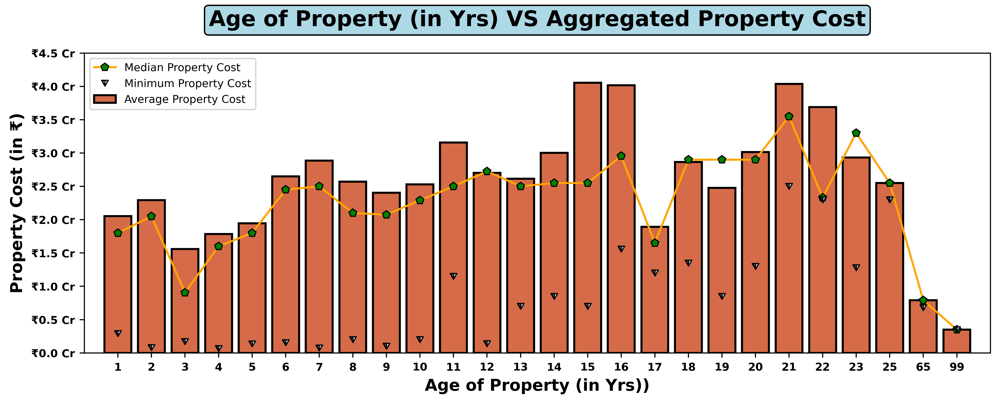

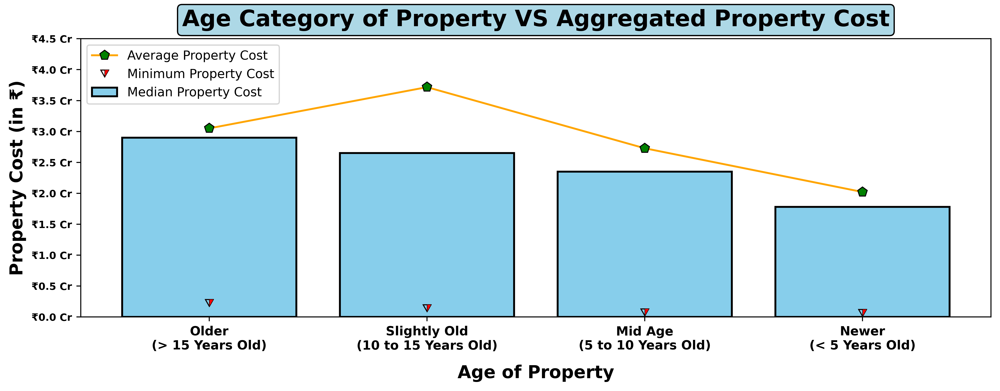

In [87]:
def Age_of_Property_VS_Agg_Property_Cost():
    ## Preparing data for Plot:
    data = df[(df["Sector"] != '-') & (df['Price_in_rupees'] <= 25e7) & 
                (df['Age_of_property_in_years'] != '-')].astype({'Age_of_property_in_years':'int32'})
    
    ## Grouping data based on Age of the Property (in Yrs) and finding mean and median "Property Price" 
    ## for each of the group:
    def func_bed(data):
        pro_pri = data['Price_in_rupees']
        return pd.Series([pro_pri.size, pro_pri.min(), pro_pri.max(), pro_pri.mean(), pro_pri.median()],
                         index = pd.MultiIndex.from_tuples([('Price', 'tot_prop_listed'), 
                                                            ('Price', 'min'), 
                                                            ('Price', 'max'),
                                                            ('Price', 'mean'), 
                                                            ('Price', 'median')]))
    
    data = data.groupby(by = 'Age_of_property_in_years').apply(func_bed).astype({
                                                                ('Price', 'tot_prop_listed'):'int32'})
    data = data.sort_index().reset_index().astype({'Age_of_property_in_years':'str'})
    
    ## ------------------------------------------------------------------------------------------------
    ## Creating Plot: 
    fig = plt.figure(figsize = (12,4), dpi = 500)
    ax = fig.add_subplot(1,1,1)
    bbox={'facecolor': 'lightblue',     # Background color
                       'edgecolor': 'black',         # Border color
                       'boxstyle': 'round, pad=0.2', # Rounded box, with padding
                       'linewidth': 1                # Border thickness
                      }
    
    ax.bar(height = data[('Price', 'mean')], x = data['Age_of_property_in_years'].astype(str), 
           color='#D56B48', linewidth=1.5, edgecolor='black', label = 'Average Property Cost')
    
    ax.plot(data['Age_of_property_in_years'].astype(str), data[('Price', 'median')], color='orange', 
            linewidth=1.5, label = 'Median Property Cost', marker = 'p', markersize  = 6, 
            markerfacecolor='green',markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.plot(data['Age_of_property_in_years'].astype(str), data[('Price', 'min')], linewidth=0, 
            label = 'Minimum Property Cost', marker = '$⧩$', markersize  = 5,  markerfacecolor='skyblue',
            markeredgecolor='black', markeredgewidth = 0.8)
    #▼ ◭  ⨻ Triangle Symbols
    
    ax.set_title('Age of Property (in Yrs) VS Aggregated Property Cost', 
                 fontsize=16, fontweight='bold', bbox = bbox, pad = 20)
    ax.set_ylabel('Property Cost (in ₹)', fontsize=12, fontweight='bold')
    ax.set_xlabel('Age of Property (in Yrs))', fontsize=12, fontweight='bold')
    
    ax.set_xlim(-1, 26)
    ax.set_xticks(list(range(0, 26)))
    ax.set_xticklabels(data['Age_of_property_in_years'].astype(str), rotation = 0, fontsize = 8, 
                       fontweight = 'bold')
    
    ax.set_ylim(0,4.5e7)
    ax.set_yticks(list(range(0, 45000001, 5000000)))
    ax.set_yticklabels([f"₹{round(i/10000000, 2)} Cr" for i in range(0, 45000001, 5000000)], 
                       fontsize = 8, fontweight = 'bold')
    
    ax.legend(fontsize=8, loc = 'upper left')
    
    plt.show()


Age_of_Property_VS_Agg_Property_Cost()

## ------------------------------------------------------------------------------------------------------------------
## ------------------------------------------------------------------------------------------------------------------

def Age_category_of_Property_VS_Agg_Property_Cost():
    ## Preparing data for Plot:
    data = df[df['Age_of_property_in_years'] != '-'].reset_index(drop=True).astype({'Age_of_property_in_years':'int32'})
    
    ## Grouping Properties based on their Age in Years and finding 'Mean' and 'Median' Property Price for each of the group:
    def func_new(i):
        if data.iloc[i]['Age_of_property_in_years'] <= 5:
            return "Newer Property"
        elif data.iloc[i]['Age_of_property_in_years'] > 5 and data.iloc[i]['Age_of_property_in_years'] <= 10:
            return "Mid Age Property"
        elif data.iloc[i]['Age_of_property_in_years'] > 10 and data.iloc[i]['Age_of_property_in_years'] <= 15:
            return "Slightly Older"
        elif data.iloc[i]['Age_of_property_in_years'] > 15:
            return "Older Property"
    
    
    def func_bed(data):
        pro_pri = data['Price_in_rupees']
        return pd.Series([pro_pri.size, pro_pri.min(), pro_pri.max(), pro_pri.mean(), pro_pri.median()],
                         index = pd.MultiIndex.from_tuples([('Price', 'tot_prop_listed'), ('Price', 'min'), 
                                                            ('Price', 'max'), ('Price', 'mean'), ('Price', 'median')]))
    
    data = data.groupby(by = func_new).apply(func_bed).astype({('Price', 'tot_prop_listed'):'int32'})
    data = data.sort_values(by= ('Price', 'median'), ascending=False)
    
    ## -----------------------------------------------------------------------------------------------------------------
    ## Creating Plot: 
    fig = plt.figure(figsize = (13,4), dpi = 500)
    ax = fig.add_subplot(1,1,1)
    bbox={'facecolor': 'lightblue',     # Background color
                       'edgecolor': 'black',         # Border color
                       'boxstyle': 'round, pad=0.2', # Rounded box, with padding
                       'linewidth': 1                # Border thickness
                      }
    
    ax.bar(height = data[('Price', 'median')], x = data.index, color='skyblue', linewidth=1.5, edgecolor='black', 
           label = 'Median Property Cost')
    
    ax.plot(data.index, data[('Price', 'mean')], color='orange',
            linewidth=1.5, label = 'Average Property Cost', marker = 'p', markersize  = 8, 
            markerfacecolor='green',markeredgecolor='black', markeredgewidth = 0.8)
    
    ax.plot(data.index, data[('Price', 'min')], linewidth=0, 
            label = 'Minimum Property Cost', marker = '$⧩$', markersize  = 7,  markerfacecolor='red',
            markeredgecolor='black', markeredgewidth = 0.4)
    
    ax.set_title('Age Category of Property VS Aggregated Property Cost', 
                 fontsize=18, fontweight='bold', bbox = bbox, pad = 10)
    ax.set_ylabel('Property Cost (in ₹)', fontsize=14, fontweight='bold')
    ax.set_xlabel('Age of Property', fontsize=14, fontweight='bold', labelpad=10)
    
    ax.set_xticks(list(range(4)))
    ax.set_xticklabels(["Older\n(> 15 Years Old)", "Slightly Old\n(10 to 15 Years Old)",
                       "Mid Age\n(5 to 10 Years Old)", "Newer\n(< 5 Years Old)"], fontsize = 10, fontweight = 'bold')
    
    ax.set_ylim(0,4.5e7)
    ax.set_yticks(list(range(0, 45000001, 5000000)))
    ax.set_yticklabels([f"₹{round(i/10000000, 2)} Cr" for i in range(0, 45000001, 5000000)], 
                       fontsize = 8, fontweight = 'bold')
    
    ax.legend(fontsize=10, loc = 'upper left')
    plt.show()


Age_category_of_Property_VS_Agg_Property_Cost()

### **`🔍 OBSERVATIONS :`**
* **Newer Properties (1–5 years):** **Average costs range between ₹1.5–2.2 Cr**, with **some low outliers**.
* **Mid-Age Properties (6–15 years):** **Average costs generally increase**, peaking around ₹2.5–3 Cr, with stable median values.
* **Properties aged 16–25 years:** Show **higher average and median costs**, with some peaks above ₹4 Cr, indicating premium resale.
* **Very Old Properties (65+ years):** **Both average and median property costs drop significantly**, well below ₹1 Cr.
* **Minimum Costs:** Outliers exist across all age groups, showing **some undervalued/low-demand properties**.


### **`💡 Intepretation`**
* Property prices **DO NOT decline linearly with age**; **instead**, they show **mid-age appreciation**, likely due to **established infrastructure and mature localities**.
* **New properties** are **priced competitively** but **not always the costliest**, reflecting developer pricing strategies and buyer caution.
* **Mid-to-old properties (10–25 years)** often **command higher values** due to prime locations, scarcity of land, or reputation of projects.
* **Very old properties (>60 years)** lose market value due to aging construction, lack of amenities, and redeveent pressure.


### **`🎯 Implicatin for Stakeholders`**
* **Homebuyers:**
  * Newer properties **offer modern amenities** but not always the highest appreciation potential.
  * Mid-age properties (10–20 years) may provide the best value balance of location and price stability.
  * Very old properties may **come cheaper** but **often require renovation or redevlopment**.
* **Developers:**
  * **Redevelopment opportunities exist in aging properties** (>40–50 years).
  * **New launches should emphasize amenities** and **future value appreciation** to compet with mid-aged prime properties.
* **Investors:**
  * **Mid-aged properties** offer **strong resale value** and **potential for appreciation**.
  * Very old properties may be high-risk unless targeted for **redevelopment investent**.

---

### **`✅ CONCLUSION :`**
**Property cost** in Gurugram **shows** a **non-linear relationship with age**. While very old properties lose value, **mid-aged properties (10–25 years old) command higher market prices** due to established infrastructure, location advantage, with added scarcity. **New properties, though modern, compete in pricing with mid-age assets**, and **redevelopment potential makes older properties a niche investment play**. This **highlights** the **importance of considering age alongside location in property valuations**.
<br><br>

---
---

<br><br><br>

# **`This is end of Part 1!`**
# **`Jump to Part 2 of EDA Document!!! Part 2 is even more interesting...`**